In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline
import matplotlib.pyplot as plt

In [2]:
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error,mean_squared_error,r2_score

In [3]:
data=pd.read_csv('train.csv')

In [4]:
data.shape

(1460, 81)

In [5]:
test_df=pd.read_csv('test.csv')

In [6]:
test_df.shape

(1459, 80)

In [7]:
data['BedroomAbvGr'].value_counts()          # BedroomAbvGr #TotRmsAbvGrd #Utilities #KitchenAbvGr 

3    804
2    358
4    213
1     50
5     21
6      7
0      6
8      1
Name: BedroomAbvGr, dtype: int64

In [8]:
test_df['BedroomAbvGr'].value_counts()

3    792
2    384
4    187
1     53
5     27
6     14
0      2
Name: BedroomAbvGr, dtype: int64

In [9]:
final_df=pd.concat([data,test_df],axis=0)

# EDA

In [10]:
final_df.shape                                                  # 2919 rows and 81 columns

(2919, 81)

In [11]:
pd.set_option('display.max_columns',100)
pd.set_option('display.max_rows',3000)

In [12]:
final_df.head()

,1stFlrSF,2ndFlrSF,3SsnPorch,Alley,BedroomAbvGr,BldgType,BsmtCond,BsmtExposure,BsmtFinSF1,BsmtFinSF2,BsmtFinType1,BsmtFinType2,BsmtFullBath,BsmtHalfBath,BsmtQual,BsmtUnfSF,CentralAir,Condition1,Condition2,Electrical,EnclosedPorch,ExterCond,ExterQual,Exterior1st,Exterior2nd,Fence,FireplaceQu,Fireplaces,Foundation,FullBath,Functional,GarageArea,GarageCars,GarageCond,GarageFinish,GarageQual,GarageType,GarageYrBlt,GrLivArea,HalfBath,Heating,HeatingQC,HouseStyle,Id,KitchenAbvGr,KitchenQual,LandContour,LandSlope,LotArea,LotConfig,LotFrontage,LotShape,LowQualFinSF,MSSubClass,MSZoning,MasVnrArea,MasVnrType,MiscFeature,MiscVal,MoSold,Neighborhood,OpenPorchSF,OverallCond,OverallQual,PavedDrive,PoolArea,PoolQC,RoofMatl,RoofStyle,SaleCondition,SalePrice,SaleType,ScreenPorch,Street,TotRmsAbvGrd,TotalBsmtSF,Utilities,WoodDeckSF,YearBuilt,YearRemodAdd,YrSold
0,856,854,0,NaN,3,1Fam,TA,No,706.0,0.0,GLQ,Unf,1.0,0.0,Gd,150.0,Y,Norm,Norm,SBrkr,0,TA,Gd,VinylSd,VinylSd,NaN,NaN,0,PConc,2,Typ,548.0,2.0,TA,RFn,TA,Attchd,2003.0,1710,1,GasA,Ex,2Story,1,1,Gd,Lvl,Gtl,8450,Inside,65.0,Reg,0,60,RL,196.0,BrkFace,NaN,0,2,CollgCr,61,5,7,Y,0,NaN,CompShg,Gable,Normal,208500.0,WD,0,Pave,8,856.0,AllPub,0,2003,2003,2008
1,1262,0,0,NaN,3,1Fam,TA,Gd,978.0,0.0,ALQ,Unf,0.0,1.0,Gd,284.0,Y,Feedr,Norm,SBrkr,0,TA,TA,MetalSd,MetalSd,NaN,TA,1,CBlock,2,Typ,460.0,2.0,TA,RFn,TA,Attchd,1976.0,1262,0,GasA,Ex,1Story,2,1,TA,Lvl,Gtl,9600,FR2,80.0,Reg,0,20,RL,0.0,None,NaN,0,5,Veenker,0,8,6,Y,0,NaN,CompShg,Gable,Normal,181500.0,WD,0,Pave,6,1262.0,AllPub,298,1976,1976,2007
2,920,866,0,NaN,3,1Fam,TA,Mn,486.0,0.0,GLQ,Unf,1.0,0.0,Gd,434.0,Y,Norm,Norm,SBrkr,0,TA,Gd,VinylSd,VinylSd,NaN,TA,1,PConc,2,Typ,608.0,2.0,TA,RFn,TA,Attchd,2001.0,1786,1,GasA,Ex,2Story,3,1,Gd,Lvl,Gtl,11250,Inside,68.0,IR1,0,60,RL,162.0,BrkFace,NaN,0,9,CollgCr,42,5,7,Y,0,NaN,CompShg,Gable,Normal,223500.0,WD,0,Pave,6,920.0,AllPub,0,2001,2002,2008
3,961,756,0,NaN,3,1Fam,Gd,No,216.0,0.0,ALQ,Unf,1.0,0.0,TA,540.0,Y,Norm,Norm,SBrkr,272,TA,TA,Wd Sdng,Wd Shng,NaN,Gd,1,BrkTil,1,Typ,642.0,3.0,TA,Unf,TA,Detchd,1998.0,1717,0,GasA,Gd,2Story,4,1,Gd,Lvl,Gtl,9550,Corner,60.0,IR1,0,70,RL,0.0,None,NaN,0,2,Crawfor,35,5,7,Y,0,NaN,CompShg,Gable,Abnorml,140000.0,WD,0,Pave,7,756.0,AllPub,0,1915,1970,2006
4,1145,1053,0,NaN,4,1Fam,TA,Av,655.0,0.0,GLQ,Unf,1.0,0.0,Gd,490.0,Y,Norm,Norm,SBrkr,0,TA,Gd,VinylSd,VinylSd,NaN,TA,1,PConc,2,Typ,836.0,3.0,TA,RFn,TA,Attchd,2000.0,2198,1,GasA,Ex,2Story,5,1,Gd,Lvl,Gtl,14260,FR2,84.0,IR1,0,60,RL,350.0,BrkFace,NaN,0,12,NoRidge,84,5,8,Y,0,NaN,CompShg,Gable,Normal,250000.0,WD,0,Pave,9,1145.0,AllPub,192,2000,2000,2008


In [13]:
final_df.describe()

,1stFlrSF,2ndFlrSF,3SsnPorch,BedroomAbvGr,BsmtFinSF1,BsmtFinSF2,BsmtFullBath,BsmtHalfBath,BsmtUnfSF,EnclosedPorch,Fireplaces,FullBath,GarageArea,GarageCars,GarageYrBlt,GrLivArea,HalfBath,Id,KitchenAbvGr,LotArea,LotFrontage,LowQualFinSF,MSSubClass,MasVnrArea,MiscVal,MoSold,OpenPorchSF,OverallCond,OverallQual,PoolArea,SalePrice,ScreenPorch,TotRmsAbvGrd,TotalBsmtSF,WoodDeckSF,YearBuilt,YearRemodAdd,YrSold
count,2919.000000,2919.000000,2919.000000,2919.000000,2918.000000,2918.000000,2917.000000,2917.000000,2918.000000,2919.000000,2919.000000,2919.000000,2918.000000,2918.000000,2760.000000,2919.000000,2919.000000,2919.000000,2919.000000,2919.000000,2433.000000,2919.000000,2919.000000,2896.000000,2919.000000,2919.000000,2919.000000,2919.000000,2919.000000,2919.000000,1460.000000,2919.000000,2919.000000,2918.000000,2919.000000,2919.000000,2919.000000,2919.000000
mean,1159.581706,336.483727,2.602261,2.860226,441.423235,49.582248,0.429894,0.061364,560.772104,23.098321,0.597122,1.568003,472.874572,1.766621,1978.113406,1500.759849,0.380267,1460.000000,1.044536,10168.114080,69.305795,4.694416,57.137718,102.201312,50.825968,6.213087,47.486811,5.564577,6.089072,2.251799,180921.195890,16.062350,6.451524,1051.777587,93.709832,1971.312778,1984.264474,2007.792737
std,392.362079,428.701456,25.188169,0.822693,455.610826,169.205611,0.524736,0.245687,439.543659,64.244246,0.646129,0.552969,215.394815,0.761624,25.574285,506.051045,0.502872,842.787043,0.214462,7886.996359,23.344905,46.396825,42.517628,179.334253,567.402211,2.714762,67.575493,1.113131,1.409947,35.663946,79442.502883,56.184365,1.569379,440.766258,126.526589,30.291442,20.894344,1.314964
min,334.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1895.000000,334.000000,0.000000,1.000000,0.000000,1300.000000,21.000000,0.000000,20.000000,0.000000,0.000000,1.000000,0.000000,1.000000,1.000000,0.000000,34900.000000,0.000000,2.000000,0.000000,0.000000,1872.000000,1950.000000,2006.000000
25%,876.000000,0.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000,220.000000,0.000000,0.000000,1.000000,320.000000,1.000000,1960.000000,1126.000000,0.000000,730.500000,1.000000,7478.000000,59.000000,0.000000,20.000000,0.000000,0.000000,4.000000,0.000000,5.000000,5.000000,0.000000,129975.000000,0.000000,5.000000,793.000000,0.000000,1953.500000,1965.000000,2007.000000
50%,1082.000000,0.000000,0.000000,3.000000,368.500000,0.000000,0.000000,0.000000,467.000000,0.000000,1.000000,2.000000,480.000000,2.000000,1979.000000,1444.000000,0.000000,1460.000000,1.000000,9453.000000,68.000000,0.000000,50.000000,0.000000,0.000000,6.000000,26.000000,5.000000,6.000000,0.000000,163000.000000,0.000000,6.000000,989.500000,0.000000,1973.000000,1993.000000,2008.000000
75%,1387.500000,704.000000,0.000000,3.000000,733.000000,0.000000,1.000000,0.000000,805.500000,0.000000,1.000000,2.000000,576.000000,2.000000,2002.000000,1743.500000,1.000000,2189.500000,1.000000,11570.000000,80.000000,0.000000,70.000000,164.000000,0.000000,8.000000,70.000000,6.000000,7.000000,0.000000,214000.000000,0.000000,7.000000,1302.000000,168.000000,2001.000000,2004.000000,2009.000000
max,5095.000000,2065.000000,508.000000,8.000000,5644.000000,1526.000000,3.000000,2.000000,2336.000000,1012.000000,4.000000,4.000000,1488.000000,5.000000,2207.000000,5642.000000,2.000000,2919.000000,3.000000,215245.000000,313.000000,1064.000000,190.000000,1600.000000,17000.000000,12.000000,742.000000,9.000000,10.000000,800.000000,755000.000000,576.000000,15.000000,6110.000000,1424.000000,2010.000000,2010.000000,2010.000000


In [14]:
final_df.describe(include='all')

,1stFlrSF,2ndFlrSF,3SsnPorch,Alley,BedroomAbvGr,BldgType,BsmtCond,BsmtExposure,BsmtFinSF1,BsmtFinSF2,BsmtFinType1,BsmtFinType2,BsmtFullBath,BsmtHalfBath,BsmtQual,BsmtUnfSF,CentralAir,Condition1,Condition2,Electrical,EnclosedPorch,ExterCond,ExterQual,Exterior1st,Exterior2nd,Fence,FireplaceQu,Fireplaces,Foundation,FullBath,Functional,GarageArea,GarageCars,GarageCond,GarageFinish,GarageQual,GarageType,GarageYrBlt,GrLivArea,HalfBath,Heating,HeatingQC,HouseStyle,Id,KitchenAbvGr,KitchenQual,LandContour,LandSlope,LotArea,LotConfig,LotFrontage,LotShape,LowQualFinSF,MSSubClass,MSZoning,MasVnrArea,MasVnrType,MiscFeature,MiscVal,MoSold,Neighborhood,OpenPorchSF,OverallCond,OverallQual,PavedDrive,PoolArea,PoolQC,RoofMatl,RoofStyle,SaleCondition,SalePrice,SaleType,ScreenPorch,Street,TotRmsAbvGrd,TotalBsmtSF,Utilities,WoodDeckSF,YearBuilt,YearRemodAdd,YrSold
count,2919.000000,2919.000000,2919.000000,198,2919.000000,2919,2837,2837,2918.000000,2918.000000,2840,2839,2917.000000,2917.000000,2838,2918.000000,2919,2919,2919,2918,2919.000000,2919,2919,2918,2918,571,1499,2919.000000,2919,2919.000000,2917,2918.000000,2918.000000,2760,2760,2760,2762,2760.000000,2919.000000,2919.000000,2919,2919,2919,2919.000000,2919.000000,2918,2919,2919,2919.000000,2919,2433.000000,2919,2919.000000,2919.000000,2915,2896.000000,2895,105,2919.000000,2919.000000,2919,2919.000000,2919.000000,2919.000000,2919,2919.000000,10,2919,2919,2919,1460.000000,2918,2919.000000,2919,2919.000000,2918.000000,2917,2919.000000,2919.000000,2919.000000,2919.000000
unique,NaN,NaN,NaN,2,NaN,5,4,4,NaN,NaN,6,6,NaN,NaN,4,NaN,2,9,8,5,NaN,5,4,15,16,4,5,NaN,6,NaN,7,NaN,NaN,5,3,5,6,NaN,NaN,NaN,6,5,8,NaN,NaN,4,4,3,NaN,5,NaN,4,NaN,NaN,5,NaN,4,4,NaN,NaN,25,NaN,NaN,NaN,3,NaN,3,8,6,6,NaN,9,NaN,2,NaN,NaN,2,NaN,NaN,NaN,NaN
top,NaN,NaN,NaN,Grvl,NaN,1Fam,TA,No,NaN,NaN,Unf,Unf,NaN,NaN,TA,NaN,Y,Norm,Norm,SBrkr,NaN,TA,TA,VinylSd,VinylSd,MnPrv,Gd,NaN,PConc,NaN,Typ,NaN,NaN,TA,Unf,TA,Attchd,NaN,NaN,NaN,GasA,Ex,1Story,NaN,NaN,TA,Lvl,Gtl,NaN,Inside,NaN,Reg,NaN,NaN,RL,NaN,None,Shed,NaN,NaN,NAmes,NaN,NaN,NaN,Y,NaN,Gd,CompShg,Gable,Normal,NaN,WD,NaN,Pave,NaN,NaN,AllPub,NaN,NaN,NaN,NaN
freq,NaN,NaN,NaN,120,NaN,2425,2606,1904,NaN,NaN,851,2493,NaN,NaN,1283,NaN,2723,2511,2889,2671,NaN,2538,1798,1025,1014,329,744,NaN,1308,NaN,2717,NaN,NaN,2654,1230,2604,1723,NaN,NaN,NaN,2874,1493,1471,NaN,NaN,1492,2622,2778,NaN,2133,NaN,1859,NaN,NaN,2265,NaN,1742,95,NaN,NaN,443,NaN,NaN,NaN,2641,NaN,4,2876,2310,2402,NaN,2525,NaN,2907,NaN,NaN,2916,NaN,NaN,NaN,NaN
mean,1159.581706,336.483727,2.602261,NaN,2.860226,NaN,NaN,NaN,441.423235,49.582248,NaN,NaN,0.429894,0.061364,NaN,560.772104,NaN,NaN,NaN,NaN,23.098321,NaN,NaN,NaN,NaN,NaN,NaN,0.597122,NaN,1.568003,NaN,472.874572,1.766621,NaN,NaN,NaN,NaN,1978.113406,1500.759849,0.380267,NaN,NaN,NaN,1460.000000,1.044536,NaN,NaN,NaN,10168.114080,NaN,69.305795,NaN,4.694416,57.137718,NaN,102.201312,NaN,NaN,50.825968,6.213087,NaN,47.486811,5.564577,6.089072,NaN,2.251799,NaN,NaN,NaN,NaN,180921.195890,NaN,16.062350,NaN,6.451524,1051.777587,NaN,93.709832,1971.312778,1984.264474,2007.792737
std,392.362079,428.701456,25.188169,NaN,0.822693,NaN,NaN,NaN,455.610826,169.205611,NaN,NaN,0.524736,0.245687,NaN,439.543659,NaN,NaN,NaN,NaN,64.244246,NaN,NaN,NaN,NaN,NaN,NaN,0.646129,NaN,0.552969,NaN,215.394815,0.761624,NaN,NaN,NaN,NaN,25.574285,506.051045,0.502872,NaN,NaN,NaN,842.787043,0.214462,NaN,NaN,NaN,7886.996359,NaN,23.344905,NaN,46.396825,42.517628,NaN,179.334253,NaN,NaN,567.402211,2.714762,NaN,67.575493,1.113131,1.409947,NaN,35.663946,NaN,NaN,NaN,NaN,79442.502883,NaN,56.184365,NaN,1.569379,440.766258,NaN,126.526589,30.291442,20.894344,1.314964
min,334.000000,0.000000,0.000000,NaN,0.000000,NaN,NaN,NaN,0.000000,0.000000,NaN,NaN,0.000000,0.000000,NaN,0.000000,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,0.000000,NaN,0.000000,0.000000,NaN,NaN,NaN,NaN,1895.000000,334.000000,0.000000,NaN,NaN,NaN,1.000000,0.000000,NaN,NaN,NaN,1300.000000,NaN,21.000000,NaN,0.000000,20.000000,NaN,0.000000,NaN,NaN,0.000000

In [15]:
final_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2919 entries, 0 to 1458
Data columns (total 81 columns):
1stFlrSF         2919 non-null int64
2ndFlrSF         2919 non-null int64
3SsnPorch        2919 non-null int64
Alley            198 non-null object
BedroomAbvGr     2919 non-null int64
BldgType         2919 non-null object
BsmtCond         2837 non-null object
BsmtExposure     2837 non-null object
BsmtFinSF1       2918 non-null float64
BsmtFinSF2       2918 non-null float64
BsmtFinType1     2840 non-null object
BsmtFinType2     2839 non-null object
BsmtFullBath     2917 non-null float64
BsmtHalfBath     2917 non-null float64
BsmtQual         2838 non-null object
BsmtUnfSF        2918 non-null float64
CentralAir       2919 non-null object
Condition1       2919 non-null object
Condition2       2919 non-null object
Electrical       2918 non-null object
EnclosedPorch    2919 non-null int64
ExterCond        2919 non-null object
ExterQual        2919 non-null object
Exterior1st      291

In [16]:
final_df.select_dtypes(include=['object']).columns

Index(['Alley', 'BldgType', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1',
       'BsmtFinType2', 'BsmtQual', 'CentralAir', 'Condition1', 'Condition2',
       'Electrical', 'ExterCond', 'ExterQual', 'Exterior1st', 'Exterior2nd',
       'Fence', 'FireplaceQu', 'Foundation', 'Functional', 'GarageCond',
       'GarageFinish', 'GarageQual', 'GarageType', 'Heating', 'HeatingQC',
       'HouseStyle', 'KitchenQual', 'LandContour', 'LandSlope', 'LotConfig',
       'LotShape', 'MSZoning', 'MasVnrType', 'MiscFeature', 'Neighborhood',
       'PavedDrive', 'PoolQC', 'RoofMatl', 'RoofStyle', 'SaleCondition',
       'SaleType', 'Street', 'Utilities'],
      dtype='object')

In [17]:
final_df.select_dtypes(include=['int','float64']).columns

Index(['BsmtFinSF1', 'BsmtFinSF2', 'BsmtFullBath', 'BsmtHalfBath', 'BsmtUnfSF',
       'GarageArea', 'GarageCars', 'GarageYrBlt', 'LotFrontage', 'MasVnrArea',
       'SalePrice', 'TotalBsmtSF'],
      dtype='object')

In [18]:
final_df.isnull().sum() 

1stFlrSF            0
2ndFlrSF            0
3SsnPorch           0
Alley            2721
BedroomAbvGr        0
BldgType            0
BsmtCond           82
BsmtExposure       82
BsmtFinSF1          1
BsmtFinSF2          1
BsmtFinType1       79
BsmtFinType2       80
BsmtFullBath        2
BsmtHalfBath        2
BsmtQual           81
BsmtUnfSF           1
CentralAir          0
Condition1          0
Condition2          0
Electrical          1
EnclosedPorch       0
ExterCond           0
ExterQual           0
Exterior1st         1
Exterior2nd         1
Fence            2348
FireplaceQu      1420
Fireplaces          0
Foundation          0
FullBath            0
Functional          2
GarageArea          1
GarageCars          1
GarageCond        159
GarageFinish      159
GarageQual        159
GarageType        157
GarageYrBlt       159
GrLivArea           0
HalfBath            0
Heating             0
HeatingQC           0
HouseStyle          0
Id                  0
KitchenAbvGr        0
KitchenQua

In [19]:
[col for col in data.columns if final_df[col].isnull().any()]   # Displaying all columns with null values

['MSZoning',
 'LotFrontage',
 'Alley',
 'Utilities',
 'Exterior1st',
 'Exterior2nd',
 'MasVnrType',
 'MasVnrArea',
 'BsmtQual',
 'BsmtCond',
 'BsmtExposure',
 'BsmtFinType1',
 'BsmtFinSF1',
 'BsmtFinType2',
 'BsmtFinSF2',
 'BsmtUnfSF',
 'TotalBsmtSF',
 'Electrical',
 'BsmtFullBath',
 'BsmtHalfBath',
 'KitchenQual',
 'Functional',
 'FireplaceQu',
 'GarageType',
 'GarageYrBlt',
 'GarageFinish',
 'GarageCars',
 'GarageArea',
 'GarageQual',
 'GarageCond',
 'PoolQC',
 'Fence',
 'MiscFeature',
 'SaleType',
 'SalePrice']

In [20]:
null_values = final_df.isnull().sum()                                     # All null values columns in descending order
null_values = null_values[null_values>0]
print('all null:\n')
print(null_values.sort_values(ascending=False))

all null:

PoolQC          2909
MiscFeature     2814
Alley           2721
Fence           2348
SalePrice       1459
FireplaceQu     1420
LotFrontage      486
GarageQual       159
GarageCond       159
GarageFinish     159
GarageYrBlt      159
GarageType       157
BsmtExposure      82
BsmtCond          82
BsmtQual          81
BsmtFinType2      80
BsmtFinType1      79
MasVnrType        24
MasVnrArea        23
MSZoning           4
BsmtFullBath       2
BsmtHalfBath       2
Utilities          2
Functional         2
Electrical         1
BsmtUnfSF          1
Exterior1st        1
Exterior2nd        1
TotalBsmtSF        1
GarageCars         1
BsmtFinSF2         1
BsmtFinSF1         1
KitchenQual        1
SaleType           1
GarageArea         1
dtype: int64


In [21]:
null_value_percentage=final_df.isnull().sum()/final_df.shape[0]*100
null_value_percentage

1stFlrSF          0.000000
2ndFlrSF          0.000000
3SsnPorch         0.000000
Alley            93.216855
BedroomAbvGr      0.000000
BldgType          0.000000
BsmtCond          2.809181
BsmtExposure      2.809181
BsmtFinSF1        0.034258
BsmtFinSF2        0.034258
BsmtFinType1      2.706406
BsmtFinType2      2.740665
BsmtFullBath      0.068517
BsmtHalfBath      0.068517
BsmtQual          2.774923
BsmtUnfSF         0.034258
CentralAir        0.000000
Condition1        0.000000
Condition2        0.000000
Electrical        0.034258
EnclosedPorch     0.000000
ExterCond         0.000000
ExterQual         0.000000
Exterior1st       0.034258
Exterior2nd       0.034258
Fence            80.438506
FireplaceQu      48.646797
Fireplaces        0.000000
Foundation        0.000000
FullBath          0.000000
Functional        0.068517
GarageArea        0.034258
GarageCars        0.034258
GarageCond        5.447071
GarageFinish      5.447071
GarageQual        5.447071
GarageType        5.378554
G

In [22]:
final_df=final_df.set_index('Id') 

In [23]:
final_df

,1stFlrSF,2ndFlrSF,3SsnPorch,Alley,BedroomAbvGr,BldgType,BsmtCond,BsmtExposure,BsmtFinSF1,BsmtFinSF2,BsmtFinType1,BsmtFinType2,BsmtFullBath,BsmtHalfBath,BsmtQual,BsmtUnfSF,CentralAir,Condition1,Condition2,Electrical,EnclosedPorch,ExterCond,ExterQual,Exterior1st,Exterior2nd,Fence,FireplaceQu,Fireplaces,Foundation,FullBath,Functional,GarageArea,GarageCars,GarageCond,GarageFinish,GarageQual,GarageType,GarageYrBlt,GrLivArea,HalfBath,Heating,HeatingQC,HouseStyle,KitchenAbvGr,KitchenQual,LandContour,LandSlope,LotArea,LotConfig,LotFrontage,LotShape,LowQualFinSF,MSSubClass,MSZoning,MasVnrArea,MasVnrType,MiscFeature,MiscVal,MoSold,Neighborhood,OpenPorchSF,OverallCond,OverallQual,PavedDrive,PoolArea,PoolQC,RoofMatl,RoofStyle,SaleCondition,SalePrice,SaleType,ScreenPorch,Street,TotRmsAbvGrd,TotalBsmtSF,Utilities,WoodDeckSF,YearBuilt,YearRemodAdd,YrSold
Id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1,856,854,0,NaN,3,1Fam,TA,No,706.0,0.0,GLQ,Unf,1.0,0.0,Gd,150.0,Y,Norm,Norm,SBrkr,0,TA,Gd,VinylSd,VinylSd,NaN,NaN,0,PConc,2,Typ,548.0,2.0,TA,RFn,TA,Attchd,2003.0,1710,1,GasA,Ex,2Story,1,Gd,Lvl,Gtl,8450,Inside,65.0,Reg,0,60,RL,196.0,BrkFace,NaN,0,2,CollgCr,61,5,7,Y,0,NaN,CompShg,Gable,Normal,208500.0,WD,0,Pave,8,856.0,AllPub,0,2003,2003,2008
2,1262,0,0,NaN,3,1Fam,TA,Gd,978.0,0.0,ALQ,Unf,0.0,1.0,Gd,284.0,Y,Feedr,Norm,SBrkr,0,TA,TA,MetalSd,MetalSd,NaN,TA,1,CBlock,2,Typ,460.0,2.0,TA,RFn,TA,Attchd,1976.0,1262,0,GasA,Ex,1Story,1,TA,Lvl,Gtl,9600,FR2,80.0,Reg,0,20,RL,0.0,None,NaN,0,5,Veenker,0,8,6,Y,0,NaN,CompShg,Gable,Normal,181500.0,WD,0,Pave,6,1262.0,AllPub,298,1976,1976,2007
3,920,866,0,NaN,3,1Fam,TA,Mn,486.0,0.0,GLQ,Unf,1.0,0.0,Gd,434.0,Y,Norm,Norm,SBrkr,0,TA,Gd,VinylSd,VinylSd,NaN,TA,1,PConc,2,Typ,608.0,2.0,TA,RFn,TA,Attchd,2001.0,1786,1,GasA,Ex,2Story,1,Gd,Lvl,Gtl,11250,Inside,68.0,IR1,0,60,RL,162.0,BrkFace,NaN,0,9,CollgCr,42,5,7,Y,0,NaN,CompShg,Gable,Normal,223500.0,WD,0,Pave,6,920.0,AllPub,0,2001,2002,2008
4,961,756,0,NaN,3,1Fam,Gd,No,216.0,0.0,ALQ,Unf,1.0,0.0,TA,540.0,Y,Norm,Norm,SBrkr,272,TA,TA,Wd Sdng,Wd Shng,NaN,Gd,1,BrkTil,1,Typ,642.0,3.0,TA,Unf,TA,Detchd,1998.0,1717,0,GasA,Gd,2Story,1,Gd,Lvl,Gtl,9550,Corner,60.0,IR1,0,70,RL,0.0,None,NaN,0,2,Crawfor,35,5,7,Y,0,NaN,CompShg,Gable,Abnorml,140000.0,WD,0,Pave,7,756.0,AllPub,0,1915,1970,2006
5,1145,1053,0,NaN,4,1Fam,TA,Av,655.0,0.0,GLQ,Unf,1.0,0.0,Gd,490.0,Y,Norm,Norm,SBrkr,0,TA,Gd,VinylSd,VinylSd,NaN,TA,1,PConc,2,Typ,836.0,3.0,TA,RFn,TA,Attchd,2000.0,2198,1,GasA,Ex,2Story,1,Gd,Lvl,Gtl,14260,FR2,84.0,IR1,0,60,RL,350.0,BrkFace,NaN,0,12,NoRidge,84,5,8,Y,0,NaN,CompShg,Gable,Normal,250000.0,WD,0,Pave,9,1145.0,AllPub,192,2000,2000,2008
6,796,566,320,NaN,1,1Fam,TA,No,732.0,0.0,GLQ,Unf,1.0,0.0,Gd,64.0,Y,Norm,Norm,SBrkr,0,TA,TA,VinylSd,VinylSd,MnPrv,NaN,0,Wood,1,Typ,480.0,2.0,TA,Unf,TA,Attchd,1993.0,1362,1,GasA,Ex,1.5Fin,1,TA,Lvl,Gtl,14115,Inside,85.0,IR1,0,50,RL,0.0,None,Shed,700,10,Mitchel,30,5,5,Y,0,NaN,CompShg,Gable,Normal,143000.0,WD,0,Pave,5,796.0,AllPub,40,1993,1995,2009
7,1694,0,0,NaN,3,1Fam,TA,Av,1369.0,0.0,GLQ,Unf,1.0,0.0,Ex,317.0,Y,Norm,Norm,SBrkr,0,TA,Gd,VinylSd,VinylSd,NaN,Gd,1,PConc,2,Typ,636.0,2.0,TA,RFn,TA,Attchd,2004.0,1694,0,GasA,Ex,1Story,1,Gd,Lvl,Gtl,10084,Inside,75.0,Reg,0,20,RL,186.0,Stone,NaN,0,8,Somerst,57,5,8,Y,0,NaN,CompShg,Gable,Normal,307000.0,WD,0,Pave,7,1686.0,AllPub,255,2004,2005,2007
8,1107,983,0,NaN,3,1Fam,TA,Mn,859.0,32.0,ALQ,BLQ,1.0,0.0,Gd,216.0,Y,PosN,Norm,SBrkr,228,TA,TA,HdBoard,HdBoard,NaN,TA,2,CBlock,2,Typ,484.0,2.0,TA,RFn,TA,Attchd,1973.0,2090,1,GasA,Ex,2Story,1,TA,Lvl,Gtl,10382,Corner,NaN,IR1,0,60,RL,240.0,Stone,Shed,350,11,NWAmes,204,6,7,Y,0,NaN,CompShg,Gable,Normal,200000.0,WD,0,Pave,7,1107.0,AllPub,235,1973,1973,2009
9,1022,752,0,NaN,2,1Fam,TA,No,0.0,0.0,Unf,Unf,0.0,0.0,TA,952.0,Y,Artery,Norm,FuseF,205,TA,TA,BrkFace,Wd Shng,NaN,TA,2,BrkTil,2,Min1,468.0,2.0,TA,Unf,Fa,Detchd,1931.0,1774,0,GasA,Gd,1.5Fin,2,TA,Lvl,Gtl,6120,Inside,51.0,Reg,0,50,RM,0.0,None,NaN,0,4,OldTown,0,5,7,Y,0,NaN,CompShg,Gable,Abnorml,129900.0,WD,0,Pave,8,

# Data cleaning

In [24]:
drop_columns=null_value_percentage[null_value_percentage > 20].keys()

In [25]:
drop_columns

Index(['Alley', 'Fence', 'FireplaceQu', 'MiscFeature', 'PoolQC', 'SalePrice'], dtype='object')

In [26]:
final_df.drop(['Alley'],axis=1,inplace=True)
final_df.drop(['Fence'],axis=1,inplace=True)
final_df.drop(['FireplaceQu'],axis=1,inplace=True)
final_df.drop(['MiscFeature'],axis=1,inplace=True)
final_df.drop(['PoolQC'],axis=1,inplace=True)

# Data Imputation

In [27]:
missing_cols=final_df.columns[final_df.isnull().any()]
missing_cols

Index(['BsmtCond', 'BsmtExposure', 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtFinType1',
       'BsmtFinType2', 'BsmtFullBath', 'BsmtHalfBath', 'BsmtQual', 'BsmtUnfSF',
       'Electrical', 'Exterior1st', 'Exterior2nd', 'Functional', 'GarageArea',
       'GarageCars', 'GarageCond', 'GarageFinish', 'GarageQual', 'GarageType',
       'GarageYrBlt', 'KitchenQual', 'LotFrontage', 'MSZoning', 'MasVnrArea',
       'MasVnrType', 'SalePrice', 'SaleType', 'TotalBsmtSF', 'Utilities'],
      dtype='object')

In [28]:
bsmt_col=['BsmtCond','BsmtExposure','BsmtFinSF1','BsmtFinSF2','BsmtFinType1','BsmtFinType2','BsmtFullBath','BsmtHalfBath','BsmtQual','BsmtUnfSF','TotalBsmtSF']
bsmt_feat=final_df[bsmt_col]
bsmt_feat.head(20)

,BsmtCond,BsmtExposure,BsmtFinSF1,BsmtFinSF2,BsmtFinType1,BsmtFinType2,BsmtFullBath,BsmtHalfBath,BsmtQual,BsmtUnfSF,TotalBsmtSF
Id,,,,,,,,,,,
1,TA,No,706.0,0.0,GLQ,Unf,1.0,0.0,Gd,150.0,856.0
2,TA,Gd,978.0,0.0,ALQ,Unf,0.0,1.0,Gd,284.0,1262.0
3,TA,Mn,486.0,0.0,GLQ,Unf,1.0,0.0,Gd,434.0,920.0
4,Gd,No,216.0,0.0,ALQ,Unf,1.0,0.0,TA,540.0,756.0
5,TA,Av,655.0,0.0,GLQ,Unf,1.0,0.0,Gd,490.0,1145.0
6,TA,No,732.0,0.0,GLQ,Unf,1.0,0.0,Gd,64.0,796.0
7,TA,Av,1369.0,0.0,GLQ,Unf,1.0,0.0,Ex,317.0,1686.0
8,TA,Mn,859.0,32.0,ALQ,BLQ,1.0,0.0,Gd,216.0,1107.0
9,TA,No,0.0,0.0,Unf,Unf,0.0,0.0,TA,952.0,952.0


In [29]:
bsmt_feat.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2919 entries, 1 to 2919
Data columns (total 11 columns):
BsmtCond        2837 non-null object
BsmtExposure    2837 non-null object
BsmtFinSF1      2918 non-null float64
BsmtFinSF2      2918 non-null float64
BsmtFinType1    2840 non-null object
BsmtFinType2    2839 non-null object
BsmtFullBath    2917 non-null float64
BsmtHalfBath    2917 non-null float64
BsmtQual        2838 non-null object
BsmtUnfSF       2918 non-null float64
TotalBsmtSF     2918 non-null float64
dtypes: float64(6), object(5)
memory usage: 273.7+ KB


In [30]:
bsmt_feat=bsmt_feat[bsmt_feat.isnull().any(axis=1)]
bsmt_feat

,BsmtCond,BsmtExposure,BsmtFinSF1,BsmtFinSF2,BsmtFinType1,BsmtFinType2,BsmtFullBath,BsmtHalfBath,BsmtQual,BsmtUnfSF,TotalBsmtSF
Id,,,,,,,,,,,
18,NaN,NaN,0.0,0.0,NaN,NaN,0.0,0.0,NaN,0.0,0.0
40,NaN,NaN,0.0,0.0,NaN,NaN,0.0,0.0,NaN,0.0,0.0
91,NaN,NaN,0.0,0.0,NaN,NaN,0.0,0.0,NaN,0.0,0.0
103,NaN,NaN,0.0,0.0,NaN,NaN,0.0,0.0,NaN,0.0,0.0
157,NaN,NaN,0.0,0.0,NaN,NaN,0.0,0.0,NaN,0.0,0.0
183,NaN,NaN,0.0,0.0,NaN,NaN,0.0,0.0,NaN,0.0,0.0
260,NaN,NaN,0.0,0.0,NaN,NaN,0.0,0.0,NaN,0.0,0.0
333,TA,No,1124.0,479.0,GLQ,NaN,1.0,0.0,Gd,1603.0,3206.0
343,NaN,NaN,0.0,0.0,NaN,NaN,0.0,0.0,NaN,0.0,0.0


In [31]:
bsmt_feat_all_nan= bsmt_feat[(bsmt_feat.isnull() | bsmt_feat.isin([0])).all(1)]

In [32]:
bsmt_feat_all_nan

,BsmtCond,BsmtExposure,BsmtFinSF1,BsmtFinSF2,BsmtFinType1,BsmtFinType2,BsmtFullBath,BsmtHalfBath,BsmtQual,BsmtUnfSF,TotalBsmtSF
Id,,,,,,,,,,,
18,NaN,NaN,0.0,0.0,NaN,NaN,0.0,0.0,NaN,0.0,0.0
40,NaN,NaN,0.0,0.0,NaN,NaN,0.0,0.0,NaN,0.0,0.0
91,NaN,NaN,0.0,0.0,NaN,NaN,0.0,0.0,NaN,0.0,0.0
103,NaN,NaN,0.0,0.0,NaN,NaN,0.0,0.0,NaN,0.0,0.0
157,NaN,NaN,0.0,0.0,NaN,NaN,0.0,0.0,NaN,0.0,0.0
183,NaN,NaN,0.0,0.0,NaN,NaN,0.0,0.0,NaN,0.0,0.0
260,NaN,NaN,0.0,0.0,NaN,NaN,0.0,0.0,NaN,0.0,0.0
343,NaN,NaN,0.0,0.0,NaN,NaN,0.0,0.0,NaN,0.0,0.0
363,NaN,NaN,0.0,0.0,NaN,NaN,0.0,0.0,NaN,0.0,0.0


In [33]:
bsmt_feat_all_nan['BsmtFinSF2'].value_counts()

0.0    78
Name: BsmtFinSF2, dtype: int64

In [34]:
# 10:57

In [35]:
quality=list(final_df.loc[: ,final_df.dtypes == 'object'].columns.values)
quality

['BldgType',
 'BsmtCond',
 'BsmtExposure',
 'BsmtFinType1',
 'BsmtFinType2',
 'BsmtQual',
 'CentralAir',
 'Condition1',
 'Condition2',
 'Electrical',
 'ExterCond',
 'ExterQual',
 'Exterior1st',
 'Exterior2nd',
 'Foundation',
 'Functional',
 'GarageCond',
 'GarageFinish',
 'GarageQual',
 'GarageType',
 'Heating',
 'HeatingQC',
 'HouseStyle',
 'KitchenQual',
 'LandContour',
 'LandSlope',
 'LotConfig',
 'LotShape',
 'MSZoning',
 'MasVnrType',
 'Neighborhood',
 'PavedDrive',
 'RoofMatl',
 'RoofStyle',
 'SaleCondition',
 'SaleType',
 'Street',
 'Utilities']

In [36]:
for i in bsmt_col:
    if i in quality:
        bsmt_feat_all_nan[i]=bsmt_feat_all_nan[i].replace(np.nan,'NA')
    else:
        bsmt_feat_all_nan[i]=bsmt_feat_all_nan[i].replace(np.nan,0)
bsmt_feat.update(bsmt_feat_all_nan)
final_df.update(bsmt_feat_all_nan)

In [37]:
final_df

,1stFlrSF,2ndFlrSF,3SsnPorch,BedroomAbvGr,BldgType,BsmtCond,BsmtExposure,BsmtFinSF1,BsmtFinSF2,BsmtFinType1,BsmtFinType2,BsmtFullBath,BsmtHalfBath,BsmtQual,BsmtUnfSF,CentralAir,Condition1,Condition2,Electrical,EnclosedPorch,ExterCond,ExterQual,Exterior1st,Exterior2nd,Fireplaces,Foundation,FullBath,Functional,GarageArea,GarageCars,GarageCond,GarageFinish,GarageQual,GarageType,GarageYrBlt,GrLivArea,HalfBath,Heating,HeatingQC,HouseStyle,KitchenAbvGr,KitchenQual,LandContour,LandSlope,LotArea,LotConfig,LotFrontage,LotShape,LowQualFinSF,MSSubClass,MSZoning,MasVnrArea,MasVnrType,MiscVal,MoSold,Neighborhood,OpenPorchSF,OverallCond,OverallQual,PavedDrive,PoolArea,RoofMatl,RoofStyle,SaleCondition,SalePrice,SaleType,ScreenPorch,Street,TotRmsAbvGrd,TotalBsmtSF,Utilities,WoodDeckSF,YearBuilt,YearRemodAdd,YrSold
Id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1,856,854,0,3,1Fam,TA,No,706.0,0.0,GLQ,Unf,1.0,0.0,Gd,150.0,Y,Norm,Norm,SBrkr,0,TA,Gd,VinylSd,VinylSd,0,PConc,2,Typ,548.0,2.0,TA,RFn,TA,Attchd,2003.0,1710,1,GasA,Ex,2Story,1,Gd,Lvl,Gtl,8450,Inside,65.0,Reg,0,60,RL,196.0,BrkFace,0,2,CollgCr,61,5,7,Y,0,CompShg,Gable,Normal,208500.0,WD,0,Pave,8,856.0,AllPub,0,2003,2003,2008
2,1262,0,0,3,1Fam,TA,Gd,978.0,0.0,ALQ,Unf,0.0,1.0,Gd,284.0,Y,Feedr,Norm,SBrkr,0,TA,TA,MetalSd,MetalSd,1,CBlock,2,Typ,460.0,2.0,TA,RFn,TA,Attchd,1976.0,1262,0,GasA,Ex,1Story,1,TA,Lvl,Gtl,9600,FR2,80.0,Reg,0,20,RL,0.0,None,0,5,Veenker,0,8,6,Y,0,CompShg,Gable,Normal,181500.0,WD,0,Pave,6,1262.0,AllPub,298,1976,1976,2007
3,920,866,0,3,1Fam,TA,Mn,486.0,0.0,GLQ,Unf,1.0,0.0,Gd,434.0,Y,Norm,Norm,SBrkr,0,TA,Gd,VinylSd,VinylSd,1,PConc,2,Typ,608.0,2.0,TA,RFn,TA,Attchd,2001.0,1786,1,GasA,Ex,2Story,1,Gd,Lvl,Gtl,11250,Inside,68.0,IR1,0,60,RL,162.0,BrkFace,0,9,CollgCr,42,5,7,Y,0,CompShg,Gable,Normal,223500.0,WD,0,Pave,6,920.0,AllPub,0,2001,2002,2008
4,961,756,0,3,1Fam,Gd,No,216.0,0.0,ALQ,Unf,1.0,0.0,TA,540.0,Y,Norm,Norm,SBrkr,272,TA,TA,Wd Sdng,Wd Shng,1,BrkTil,1,Typ,642.0,3.0,TA,Unf,TA,Detchd,1998.0,1717,0,GasA,Gd,2Story,1,Gd,Lvl,Gtl,9550,Corner,60.0,IR1,0,70,RL,0.0,None,0,2,Crawfor,35,5,7,Y,0,CompShg,Gable,Abnorml,140000.0,WD,0,Pave,7,756.0,AllPub,0,1915,1970,2006
5,1145,1053,0,4,1Fam,TA,Av,655.0,0.0,GLQ,Unf,1.0,0.0,Gd,490.0,Y,Norm,Norm,SBrkr,0,TA,Gd,VinylSd,VinylSd,1,PConc,2,Typ,836.0,3.0,TA,RFn,TA,Attchd,2000.0,2198,1,GasA,Ex,2Story,1,Gd,Lvl,Gtl,14260,FR2,84.0,IR1,0,60,RL,350.0,BrkFace,0,12,NoRidge,84,5,8,Y,0,CompShg,Gable,Normal,250000.0,WD,0,Pave,9,1145.0,AllPub,192,2000,2000,2008
6,796,566,320,1,1Fam,TA,No,732.0,0.0,GLQ,Unf,1.0,0.0,Gd,64.0,Y,Norm,Norm,SBrkr,0,TA,TA,VinylSd,VinylSd,0,Wood,1,Typ,480.0,2.0,TA,Unf,TA,Attchd,1993.0,1362,1,GasA,Ex,1.5Fin,1,TA,Lvl,Gtl,14115,Inside,85.0,IR1,0,50,RL,0.0,None,700,10,Mitchel,30,5,5,Y,0,CompShg,Gable,Normal,143000.0,WD,0,Pave,5,796.0,AllPub,40,1993,1995,2009
7,1694,0,0,3,1Fam,TA,Av,1369.0,0.0,GLQ,Unf,1.0,0.0,Ex,317.0,Y,Norm,Norm,SBrkr,0,TA,Gd,VinylSd,VinylSd,1,PConc,2,Typ,636.0,2.0,TA,RFn,TA,Attchd,2004.0,1694,0,GasA,Ex,1Story,1,Gd,Lvl,Gtl,10084,Inside,75.0,Reg,0,20,RL,186.0,Stone,0,8,Somerst,57,5,8,Y,0,CompShg,Gable,Normal,307000.0,WD,0,Pave,7,1686.0,AllPub,255,2004,2005,2007
8,1107,983,0,3,1Fam,TA,Mn,859.0,32.0,ALQ,BLQ,1.0,0.0,Gd,216.0,Y,PosN,Norm,SBrkr,228,TA,TA,HdBoard,HdBoard,2,CBlock,2,Typ,484.0,2.0,TA,RFn,TA,Attchd,1973.0,2090,1,GasA,Ex,2Story,1,TA,Lvl,Gtl,10382,Corner,NaN,IR1,0,60,RL,240.0,Stone,350,11,NWAmes,204,6,7,Y,0,CompShg,Gable,Normal,200000.0,WD,0,Pave,7,1107.0,AllPub,235,1973,1973,2009
9,1022,752,0,2,1Fam,TA,No,0.0,0.0,Unf,Unf,0.0,0.0,TA,952.0,Y,Artery,Norm,FuseF,205,TA,TA,BrkFace,Wd Shng,2,BrkTil,2,Min1,468.0,2.0,TA,Unf,Fa,Detchd,1931.0,1774,0,GasA,Gd,1.5Fin,2,TA,Lvl,Gtl,6120,Inside,51.0,Reg,0,50,RM,0.0,None,0,4,OldTown,0,5,7,Y,0,CompShg,Gable,Abnorml,129900.0,WD,0,Pave,8,952.0,AllPub,90,1931,1950,2008


In [38]:
bsmt_feat=bsmt_feat[bsmt_feat.isin([np.nan]).any(axis=1)]
bsmt_feat

,BsmtCond,BsmtExposure,BsmtFinSF1,BsmtFinSF2,BsmtFinType1,BsmtFinType2,BsmtFullBath,BsmtHalfBath,BsmtQual,BsmtUnfSF,TotalBsmtSF
Id,,,,,,,,,,,
333,TA,No,1124.0,479.0,GLQ,NaN,1.0,0.0,Gd,1603.0,3206.0
949,TA,NaN,0.0,0.0,Unf,Unf,0.0,0.0,Gd,936.0,936.0
1488,TA,NaN,0.0,0.0,Unf,Unf,0.0,0.0,Gd,1595.0,1595.0
2041,NaN,Mn,1044.0,382.0,GLQ,Rec,1.0,0.0,Gd,0.0,1426.0
2186,NaN,No,1033.0,0.0,BLQ,Unf,0.0,1.0,TA,94.0,1127.0
2218,Fa,No,0.0,0.0,Unf,Unf,0.0,0.0,NaN,173.0,173.0
2219,TA,No,0.0,0.0,Unf,Unf,0.0,0.0,NaN,356.0,356.0
2349,TA,NaN,0.0,0.0,Unf,Unf,0.0,0.0,Gd,725.0,725.0
2525,NaN,Av,755.0,0.0,ALQ,Unf,0.0,0.0,TA,240.0,995.0


In [39]:
bsmt_feat.shape

(9, 11)

In [40]:
print(final_df['BsmtFinSF2'].max())
print(final_df['BsmtFinSF2'].min())

1526.0
0.0


In [41]:
pd.cut(range(0,1526),5)

[(-1.525, 305.0], (-1.525, 305.0], (-1.525, 305.0], (-1.525, 305.0], (-1.525, 305.0], ..., (1220.0, 1525.0], (1220.0, 1525.0], (1220.0, 1525.0], (1220.0, 1525.0], (1220.0, 1525.0]]
Length: 1526
Categories (5, interval[float64]): [(-1.525, 305.0] < (305.0, 610.0] < (610.0, 915.0] < (915.0, 1220.0] < (1220.0, 1525.0]]

In [42]:
df_slice=final_df[(final_df['BsmtFinSF2']>=305)&(final_df['BsmtFinSF2']<=610)]

In [43]:
bsmt_feat.at[333,'BsmtFinSF2']=df_slice['BsmtFinSF2'].mode()[0]

In [44]:
bsmt_feat

,BsmtCond,BsmtExposure,BsmtFinSF1,BsmtFinSF2,BsmtFinType1,BsmtFinType2,BsmtFullBath,BsmtHalfBath,BsmtQual,BsmtUnfSF,TotalBsmtSF
Id,,,,,,,,,,,
333,TA,No,1124.0,374.0,GLQ,NaN,1.0,0.0,Gd,1603.0,3206.0
949,TA,NaN,0.0,0.0,Unf,Unf,0.0,0.0,Gd,936.0,936.0
1488,TA,NaN,0.0,0.0,Unf,Unf,0.0,0.0,Gd,1595.0,1595.0
2041,NaN,Mn,1044.0,382.0,GLQ,Rec,1.0,0.0,Gd,0.0,1426.0
2186,NaN,No,1033.0,0.0,BLQ,Unf,0.0,1.0,TA,94.0,1127.0
2218,Fa,No,0.0,0.0,Unf,Unf,0.0,0.0,NaN,173.0,173.0
2219,TA,No,0.0,0.0,Unf,Unf,0.0,0.0,NaN,356.0,356.0
2349,TA,NaN,0.0,0.0,Unf,Unf,0.0,0.0,Gd,725.0,725.0
2525,NaN,Av,755.0,0.0,ALQ,Unf,0.0,0.0,TA,240.0,995.0


In [45]:
bsmt_feat['BsmtFinType2']=bsmt_feat['BsmtFinType2'].fillna(bsmt_feat['BsmtFinType2'].mode()[0])
bsmt_feat['BsmtExposure']=bsmt_feat['BsmtExposure'].fillna(bsmt_feat['BsmtExposure'].mode()[0])
bsmt_feat['BsmtCond']=bsmt_feat['BsmtCond'].replace(np.nan,final_df['BsmtCond'].mode()[0])
bsmt_feat['BsmtCond']=bsmt_feat['BsmtCond'].replace(np.nan,final_df['BsmtCond'].mode()[0])
bsmt_feat['BsmtQual']=bsmt_feat['BsmtQual'].replace(np.nan,final_df['BsmtQual'].mode()[0])                                                                    

In [46]:
final_df.update(bsmt_feat)

In [47]:
bsmt_feat.isnull().sum()

BsmtCond        0
BsmtExposure    0
BsmtFinSF1      0
BsmtFinSF2      0
BsmtFinType1    0
BsmtFinType2    0
BsmtFullBath    0
BsmtHalfBath    0
BsmtQual        0
BsmtUnfSF       0
TotalBsmtSF     0
dtype: int64

In [48]:
final_df.isnull().sum()

1stFlrSF            0
2ndFlrSF            0
3SsnPorch           0
BedroomAbvGr        0
BldgType            0
BsmtCond            0
BsmtExposure        0
BsmtFinSF1          0
BsmtFinSF2          0
BsmtFinType1        0
BsmtFinType2        0
BsmtFullBath        0
BsmtHalfBath        0
BsmtQual            0
BsmtUnfSF           0
CentralAir          0
Condition1          0
Condition2          0
Electrical          1
EnclosedPorch       0
ExterCond           0
ExterQual           0
Exterior1st         1
Exterior2nd         1
Fireplaces          0
Foundation          0
FullBath            0
Functional          2
GarageArea          1
GarageCars          1
GarageCond        159
GarageFinish      159
GarageQual        159
GarageType        157
GarageYrBlt       159
GrLivArea           0
HalfBath            0
Heating             0
HeatingQC           0
HouseStyle          0
KitchenAbvGr        0
KitchenQual         1
LandContour         0
LandSlope           0
LotArea             0
LotConfig 

In [49]:
final_df.columns[final_df.isnull().any()]

Index(['Electrical', 'Exterior1st', 'Exterior2nd', 'Functional', 'GarageArea',
       'GarageCars', 'GarageCond', 'GarageFinish', 'GarageQual', 'GarageType',
       'GarageYrBlt', 'KitchenQual', 'LotFrontage', 'MSZoning', 'MasVnrArea',
       'MasVnrType', 'SalePrice', 'SaleType', 'Utilities'],
      dtype='object')

In [50]:
final_df['GarageArea']=final_df['GarageArea'].fillna(final_df["GarageArea"].mean())
final_df['GarageCars']=final_df['GarageCars'].fillna(final_df["GarageCars"].mode()[0])
final_df['GarageCond']=final_df['GarageCond'].fillna(final_df["GarageCond"].mode()[0])
final_df['GarageFinish']=final_df['GarageFinish'].fillna(final_df["GarageFinish"].mode()[0])
final_df['GarageQual']=final_df['GarageQual'].fillna(final_df["GarageQual"].mode()[0])
final_df['GarageType']=final_df['GarageType'].fillna(final_df["GarageType"].mode()[0])
final_df['GarageYrBlt']=final_df['GarageYrBlt'].fillna(final_df["GarageYrBlt"].mode()[0])

In [51]:
final_df.columns[final_df.isnull().any()]

Index(['Electrical', 'Exterior1st', 'Exterior2nd', 'Functional', 'KitchenQual',
       'LotFrontage', 'MSZoning', 'MasVnrArea', 'MasVnrType', 'SalePrice',
       'SaleType', 'Utilities'],
      dtype='object')

In [52]:
final_df['Electrical']=final_df['Electrical'].fillna(final_df['Electrical'].mode()[0])
final_df['Exterior1st']=final_df['Exterior1st'].fillna(final_df['Exterior1st'].mode()[0])
final_df['Exterior2nd']=final_df['Exterior2nd'].fillna(final_df['Exterior2nd'].mode()[0])
final_df['Functional']=final_df['Functional'].fillna(final_df['Functional'].mode()[0])
final_df['KitchenQual']=final_df['KitchenQual'].fillna(final_df['KitchenQual'].mode()[0])
final_df['MSZoning']=final_df['MSZoning'].fillna(final_df['MSZoning'].mode()[0])
final_df['SaleType']=final_df['SaleType'].fillna(final_df['SaleType'].mode()[0])
final_df['Utilities']=final_df['Utilities'].fillna(final_df['Utilities'].mode()[0])
final_df['MasVnrType']=final_df['MasVnrType'].fillna(final_df['MasVnrType'].mode()[0])

In [53]:
final_df.columns[final_df.isnull().any()]

Index(['LotFrontage', 'MasVnrArea', 'SalePrice'], dtype='object')

In [54]:
final_df[final_df['MasVnrArea'].isnull()==True]['MasVnrArea'].unique()

array([nan])

In [55]:
final_df.loc[(final_df['MasVnrType']=='None') & (final_df['MasVnrArea'].isnull()==True),'MasVnrArea'] = 0

In [56]:
final_df.columns[final_df.isnull().any()]

Index(['LotFrontage', 'SalePrice'], dtype='object')

In [57]:
final_df['LotFrontage'].isnull().sum()

486

In [58]:
final_df['LotFrontage']=final_df['LotFrontage'].fillna(final_df['LotFrontage'].mean())

In [59]:
final_df.columns[final_df.isnull().any()]

Index(['SalePrice'], dtype='object')

# Feature Transformation

In [60]:
final_df.columns

Index(['1stFlrSF', '2ndFlrSF', '3SsnPorch', 'BedroomAbvGr', 'BldgType',
       'BsmtCond', 'BsmtExposure', 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtFinType1',
       'BsmtFinType2', 'BsmtFullBath', 'BsmtHalfBath', 'BsmtQual', 'BsmtUnfSF',
       'CentralAir', 'Condition1', 'Condition2', 'Electrical', 'EnclosedPorch',
       'ExterCond', 'ExterQual', 'Exterior1st', 'Exterior2nd', 'Fireplaces',
       'Foundation', 'FullBath', 'Functional', 'GarageArea', 'GarageCars',
       'GarageCond', 'GarageFinish', 'GarageQual', 'GarageType', 'GarageYrBlt',
       'GrLivArea', 'HalfBath', 'Heating', 'HeatingQC', 'HouseStyle',
       'KitchenAbvGr', 'KitchenQual', 'LandContour', 'LandSlope', 'LotArea',
       'LotConfig', 'LotFrontage', 'LotShape', 'LowQualFinSF', 'MSSubClass',
       'MSZoning', 'MasVnrArea', 'MasVnrType', 'MiscVal', 'MoSold',
       'Neighborhood', 'OpenPorchSF', 'OverallCond', 'OverallQual',
       'PavedDrive', 'PoolArea', 'RoofMatl', 'RoofStyle', 'SaleCondition',
       'SalePrice', 'S

In [61]:
feat_dtype_convert=['MSSubClass','YearBuilt','YearRemodAdd','GarageYrBlt','YrSold']
for i in feat_dtype_convert:
    final_df[i]=final_df[i].astype(str)

In [62]:
final_df['MoSold'].unique()

array([ 2,  5,  9, 12, 10,  8, 11,  4,  1,  7,  3,  6], dtype=int64)

In [63]:
import calendar
final_df['MoSold']=final_df['MoSold'].apply(lambda x : calendar.month_abbr[x])

In [64]:
final_df['MoSold'].unique()

array(['Feb', 'May', 'Sep', 'Dec', 'Oct', 'Aug', 'Nov', 'Apr', 'Jan',
       'Jul', 'Mar', 'Jun'], dtype=object)

# Categorical data arranged in order

In [65]:
from pandas.api.types import CategoricalDtype

In [66]:
final_df['BsmtCond']=final_df['BsmtCond'].astype(CategoricalDtype(categories=['NA','Po','Fa','TA','Gd','Ex'],ordered=True)).cat.codes

In [67]:
final_df['BsmtCond'].unique()

array([3, 4, 0, 2, 1], dtype=int64)

In [68]:
final_df['BsmtExposure']=final_df['BsmtExposure'].astype(CategoricalDtype(categories=['NA','Mn','Av','Gd'],ordered=True)).cat.codes

In [69]:
final_df['BsmtExposure'].unique()

array([-1,  3,  1,  2,  0], dtype=int64)

In [70]:
final_df['BsmtFinType1']=final_df['BsmtFinType1'].astype(CategoricalDtype(categories=['Unf','GLQ','ALQ','Rec','BLQ','LwQ','NA'],ordered=True)).cat.codes
final_df['BsmtFinType2']=final_df['BsmtFinType2'].astype(CategoricalDtype(categories=['Unf','Rec','LwQ','NA','BLQ','ALQ','GLQ'],ordered=True)).cat.codes
final_df['BsmtQual']=final_df['BsmtQual'].astype(CategoricalDtype(categories=['TA','Gd','Ex','Fa','NA'],ordered=True)).cat.codes
final_df['ExterQual']=final_df['ExterQual'].astype(CategoricalDtype(categories=['TA','Gd','Ex','Fa'],ordered=True)).cat.codes
final_df['ExterCond']=final_df['ExterCond'].astype(CategoricalDtype(categories=['TA','Gd','Fa','Ex','Po'],ordered=True)).cat.codes
final_df['Functional']=final_df['Functional'].astype(CategoricalDtype(categories=['Typ','Min2','Min1','Mod','Maj1','Maj2','Sev'],ordered=True)).cat.codes
final_df['GarageCond']=final_df['GarageCond'].astype(CategoricalDtype(categories=['TA','Fa','Gd','Po','Ex'],ordered=True)).cat.codes
final_df['GarageQual']=final_df['GarageQual'].astype(CategoricalDtype(categories=['TA','Fa','Gd','Po','Ex'],ordered=True)).cat.codes
final_df['GarageFinish']=final_df['GarageFinish'].astype(CategoricalDtype(categories=['Unf','RFn','Fin'],ordered=True)).cat.codes
final_df['HeatingQC']=final_df['HeatingQC'].astype(CategoricalDtype(categories=['Ex','Ta','Gd','Fa','Po'],ordered=True)).cat.codes
final_df['KitchenQual']=final_df['KitchenQual'].astype(CategoricalDtype(categories=['TA','Gd','Ex','Fa'],ordered=True)).cat.codes
final_df['PavedDrive']=final_df['PavedDrive'].astype(CategoricalDtype(categories=['Y','N','P'],ordered=True)).cat.codes
final_df['Utilities']=final_df['Utilities'].astype(CategoricalDtype(categories=['AllPub','NoSeWa'],ordered=True)).cat.codes

In [71]:
final_df['Utilities'].value_counts()

0    2918
1       1
Name: Utilities, dtype: int64

# Label Encoding categorical data

In [72]:
cat_cols=['MSZoning','Street','LotShape','LandContour','Utilities','LotConfig','LandSlope','Neighborhood','Condition1','Condition2','BldgType','HouseStyle','RoofStyle','RoofMatl','Exterior1st','Exterior2nd','MasVnrType','ExterQual','ExterCond','Foundation','BsmtQual','BsmtCond','BsmtExposure','BsmtFinType1','BsmtFinType2','Heating','HeatingQC','CentralAir','Electrical','KitchenQual','Functional','GarageType','GarageFinish','GarageQual','GarageCond','PavedDrive','SaleType','SaleCondition','MoSold']
le=LabelEncoder()
for i in cat_cols:
    final_df[i]=le.fit_transform(final_df[i])
final_df.dtypes

1stFlrSF           int64
2ndFlrSF           int64
3SsnPorch          int64
BedroomAbvGr       int64
BldgType           int32
BsmtCond           int64
BsmtExposure       int64
BsmtFinSF1       float64
BsmtFinSF2       float64
BsmtFinType1       int64
BsmtFinType2       int64
BsmtFullBath     float64
BsmtHalfBath     float64
BsmtQual           int64
BsmtUnfSF        float64
CentralAir         int32
Condition1         int32
Condition2         int32
Electrical         int32
EnclosedPorch      int64
ExterCond          int64
ExterQual          int64
Exterior1st        int32
Exterior2nd        int32
Fireplaces         int64
Foundation         int32
FullBath           int64
Functional         int64
GarageArea       float64
GarageCars       float64
GarageCond         int64
GarageFinish       int64
GarageQual         int64
GarageType         int32
GarageYrBlt       object
GrLivArea          int64
HalfBath           int64
Heating            int32
HeatingQC          int64
HouseStyle         int32


In [73]:
checker_df=final_df

In [74]:
final_df['GarageYrBlt']=final_df['GarageYrBlt'].apply(float)
final_df['MSSubClass']=final_df['MSSubClass'].apply(float)

In [75]:
final_df['YearBuilt']=final_df['YearBuilt'].apply(int)
final_df['YearRemodAdd']=final_df['YearRemodAdd'].apply(int)
final_df['YrSold']=final_df['YrSold'].apply(int)

## Outlier Treatment

In [76]:
final_df = final_df[(final_df['GrLivArea']<3500)]
final_df = final_df[(final_df['GarageArea']<1100)]
final_df = final_df[(final_df['1stFlrSF']<3000)]
final_df = final_df[(final_df['BsmtFinSF1']<2300)]
final_df = final_df[(final_df['LotArea']<100000)]

In [77]:
# splitting dataset to train and test to its initial state.

In [78]:
df_Train=final_df.iloc[:1428,:]
df_Test=final_df.iloc[1428:,:]

In [79]:
df_Train.shape

(1428, 75)

In [80]:
df_Test.shape

(1459, 75)

#  DataVisualization

### Distribution plot.

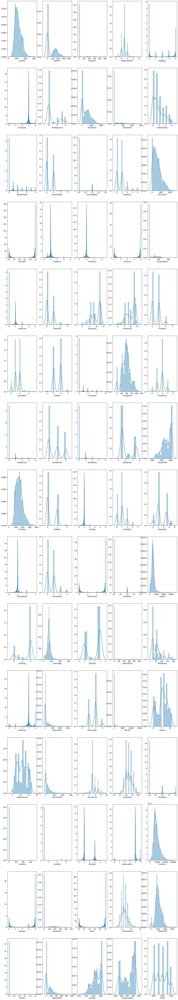

In [81]:
rows=15
cols=5
fig, ax=plt.subplots(nrows=rows,ncols=cols,figsize=(20,120))
col=df_Train.columns
index=0
for i in range(rows):
    for j in range(cols):
        sns.distplot(df_Train[col[index]],ax=ax[i][j])
        index=index+1
        
plt.show()

# Log Transformation 

In [82]:
df_Train.columns                        # Displaying all column names,copypaste this in the next cell.

Index(['1stFlrSF', '2ndFlrSF', '3SsnPorch', 'BedroomAbvGr', 'BldgType',
       'BsmtCond', 'BsmtExposure', 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtFinType1',
       'BsmtFinType2', 'BsmtFullBath', 'BsmtHalfBath', 'BsmtQual', 'BsmtUnfSF',
       'CentralAir', 'Condition1', 'Condition2', 'Electrical', 'EnclosedPorch',
       'ExterCond', 'ExterQual', 'Exterior1st', 'Exterior2nd', 'Fireplaces',
       'Foundation', 'FullBath', 'Functional', 'GarageArea', 'GarageCars',
       'GarageCond', 'GarageFinish', 'GarageQual', 'GarageType', 'GarageYrBlt',
       'GrLivArea', 'HalfBath', 'Heating', 'HeatingQC', 'HouseStyle',
       'KitchenAbvGr', 'KitchenQual', 'LandContour', 'LandSlope', 'LotArea',
       'LotConfig', 'LotFrontage', 'LotShape', 'LowQualFinSF', 'MSSubClass',
       'MSZoning', 'MasVnrArea', 'MasVnrType', 'MiscVal', 'MoSold',
       'Neighborhood', 'OpenPorchSF', 'OverallCond', 'OverallQual',
       'PavedDrive', 'PoolArea', 'RoofMatl', 'RoofStyle', 'SaleCondition',
       'SalePrice', 'S

In [83]:
skewed_features=['1stFlrSF', '2ndFlrSF', '3SsnPorch', 'BedroomAbvGr', 'BldgType',
       'BsmtCond', 'BsmtExposure', 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtFinType1',
       'BsmtFinType2', 'BsmtFullBath', 'BsmtHalfBath', 'BsmtQual', 'BsmtUnfSF',
       'CentralAir', 'Condition1', 'Condition2', 'Electrical', 'EnclosedPorch',
       'ExterCond', 'ExterQual', 'Exterior1st', 'Exterior2nd', 'Fireplaces',
       'Foundation', 'FullBath', 'Functional', 'GarageArea', 'GarageCars',
       'GarageCond', 'GarageFinish', 'GarageQual', 'GarageType', 'GarageYrBlt',
       'GrLivArea', 'HalfBath', 'Heating', 'HeatingQC', 'HouseStyle',
       'KitchenAbvGr', 'KitchenQual', 'LandContour', 'LandSlope', 'LotArea',
       'LotConfig', 'LotFrontage', 'LotShape', 'LowQualFinSF', 'MSSubClass',
       'MSZoning', 'MasVnrArea', 'MasVnrType', 'MiscVal', 'MoSold',
       'Neighborhood', 'OpenPorchSF', 'OverallCond', 'OverallQual',
       'PavedDrive', 'PoolArea', 'RoofMatl', 'RoofStyle', 'SaleCondition',
       'SalePrice', 'SaleType', 'ScreenPorch', 'Street', 'TotRmsAbvGrd',
       'TotalBsmtSF', 'Utilities', 'WoodDeckSF', 'YearBuilt', 'YearRemodAdd',
       'YrSold']

In [84]:
for i in skewed_features:
    df_Train[i]=np.log(df_Train[i]+1)

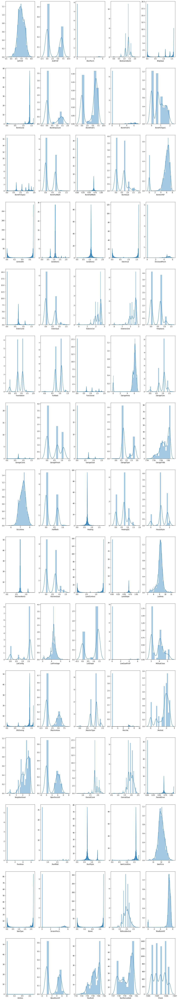

In [85]:
rows=15
cols=5
fig, ax=plt.subplots(nrows=rows,ncols=cols,figsize=(20,120))
col=df_Train.columns
index=0
for i in range(rows):
    for j in range(cols):
        sns.distplot(df_Train[col[index]],ax=ax[i][j])
        index=index+1
        
plt.show()

In [86]:
X=df_Train.drop(labels=['SalePrice'],axis=1)
Y=df_Train['SalePrice']
X.head()

,1stFlrSF,2ndFlrSF,3SsnPorch,BedroomAbvGr,BldgType,BsmtCond,BsmtExposure,BsmtFinSF1,BsmtFinSF2,BsmtFinType1,BsmtFinType2,BsmtFullBath,BsmtHalfBath,BsmtQual,BsmtUnfSF,CentralAir,Condition1,Condition2,Electrical,EnclosedPorch,ExterCond,ExterQual,Exterior1st,Exterior2nd,Fireplaces,Foundation,FullBath,Functional,GarageArea,GarageCars,GarageCond,GarageFinish,GarageQual,GarageType,GarageYrBlt,GrLivArea,HalfBath,Heating,HeatingQC,HouseStyle,KitchenAbvGr,KitchenQual,LandContour,LandSlope,LotArea,LotConfig,LotFrontage,LotShape,LowQualFinSF,MSSubClass,MSZoning,MasVnrArea,MasVnrType,MiscVal,MoSold,Neighborhood,OpenPorchSF,OverallCond,OverallQual,PavedDrive,PoolArea,RoofMatl,RoofStyle,SaleCondition,SaleType,ScreenPorch,Street,TotRmsAbvGrd,TotalBsmtSF,Utilities,WoodDeckSF,YearBuilt,YearRemodAdd,YrSold
Id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1,6.753438,6.751101,0.0,1.386294,0.0,1.386294,0.000000,6.561031,0.0,0.693147,0.0,0.693147,0.000000,0.693147,5.017280,0.693147,1.098612,1.098612,1.609438,0.000000,0.0,0.693147,2.564949,2.639057,0.000000,1.098612,1.098612,0.0,6.308098,1.098612,0.0,0.693147,0.0,0.693147,7.602900,7.444833,0.693147,0.693147,0.693147,1.791759,0.693147,0.693147,1.386294,0.0,9.042040,1.609438,4.189655,1.386294,0.0,4.110874,1.386294,5.283204,0.693147,0.0,1.386294,1.791759,4.127134,1.791759,2.079442,0.0,0.0,0.693147,0.693147,1.609438,2.197225,0.0,0.693147,2.197225,6.753438,0.0,0.000000,7.602900,7.602900,7.605392
2,7.141245,0.000000,0.0,1.386294,0.0,1.386294,1.609438,6.886532,0.0,1.098612,0.0,0.000000,0.693147,0.693147,5.652489,0.693147,0.693147,1.098612,1.609438,0.000000,0.0,0.000000,2.197225,2.197225,0.693147,0.693147,1.098612,0.0,6.133398,1.098612,0.0,0.693147,0.0,0.693147,7.589336,7.141245,0.000000,0.693147,0.693147,1.098612,0.693147,0.000000,1.386294,0.0,9.169623,1.098612,4.394449,1.386294,0.0,3.044522,1.386294,0.000000,1.098612,0.0,2.197225,3.218876,0.000000,2.197225,1.945910,0.0,0.0,0.693147,0.693147,1.609438,2.197225,0.0,0.693147,1.945910,7.141245,0.0,5.700444,7.589336,7.589336,7.604894
3,6.825460,6.765039,0.0,1.386294,0.0,1.386294,1.098612,6.188264,0.0,0.693147,0.0,0.693147,0.000000,0.693147,6.075346,0.693147,1.098612,1.098612,1.609438,0.000000,0.0,0.693147,2.564949,2.639057,0.693147,1.098612,1.098612,0.0,6.411818,1.098612,0.0,0.693147,0.0,0.693147,7.601902,7.488294,0.693147,0.693147,0.693147,1.791759,0.693147,0.693147,1.386294,0.0,9.328212,1.609438,4.234107,0.000000,0.0,4.110874,1.386294,5.093750,0.693147,0.0,2.484907,1.791759,3.761200,1.791759,2.079442,0.0,0.0,0.693147,0.693147,1.609438,2.197225,0.0,0.693147,1.945910,6.825460,0.0,0.000000,7.601902,7.602401,7.605392
4,6.869014,6.629363,0.0,1.386294,0.0,1.609438,0.000000,5.379897,0.0,1.098612,0.0,0.693147,0.000000,0.000000,6.293419,0.693147,1.098612,1.098612,1.609438,5.609472,0.0,0.000000,2.639057,2.772589,0.693147,0.000000,0.693147,0.0,6.466145,1.386294,0.0,0.000000,0.0,1.791759,7.600402,7.448916,0.000000,0.693147,1.098612,1.791759,0.693147,0.693147,1.386294,0.0,9.164401,0.000000,4.110874,0.000000,0.0,4.262680,1.386294,0.000000,1.098612,0.0,1.386294,1.945910,3.583519,1.791759,2.079442,0.0,0.0,0.693147,0.693147,0.000000,2.197225,0.0,0.693147,2.079442,6.629363,0.0,0.000000,7.557995,7.586296,7.604396
5,7.044033,6.960348,0.0,1.609438,0.0,1.386294,1.386294,6.486161,0.0,0.693147,0.0,0.693147,0.000000,0.693147,6.196444,0.693147,1.098612,1.098612,1.609438,0.000000,0.0,0.693147,2.564949,2.639057,0.693147,1.098612,1.098612,0.0,6.729824,1.386294,0.0,0.693147,0.0,0.693147,7.601402,7.695758,0.693147,0.693147,0.693147,1.791759,0.693147,0.693147,1.386294,0.0,9.565284,1.098612,4.442651,0.000000,0.0,4.110874,1.386294,5.860786,0.693147,0.0,1.098612,2.772589,4.442651,1.791759,2.197225,0.0,0.0,0.693147,0.693147,1.609438,2.197225,0.0,0.693147,2.302585,7.044033,0.0,5.262690,7.601402,7.601402,7.605392


In [87]:
X_train,X_test,Y_train,Y_test=train_test_split(X,Y,test_size=0.3,random_state=0)
print(X_train.shape,X_test.shape,Y_train.shape,Y_test.shape)

(999, 74) (429, 74) (999,) (429,)


# Scaling data.

In [88]:
scaled=StandardScaler()
X_train=scaled.fit_transform(X_train)
X_test=scaled.transform(X_test)

In [89]:
#from sklearn.preprocessing import RobustScaler
#scaler=RobustScaler()
#scaler.fit(df_Train)
#df_Train=scaler.transform(df_Train)

In [90]:
# Linear regression model

In [91]:
model=LinearRegression()
model.fit(X_train,Y_train)

LinearRegression()

In [92]:
Y_predict=model.predict(X_test)

In [93]:
score=r2_score(Y_test,Y_predict)
mae=mean_absolute_error(Y_test,Y_predict)
mse=mean_squared_error(Y_test,Y_predict)
rmse=(np.sqrt(mean_squared_error(Y_test,Y_predict)))
print('r2_score: ',score)
print('mean_absolute_error: ',mae)
print('mean_squared_error: ',mse)
print('root_mean_squared_error: ',rmse)

r2_score:  0.8841585868317438
mean_absolute_error:  0.09296759996878597
mean_squared_error:  0.017717233072331674
root_mean_squared_error:  0.13310609705168158


In [94]:
model2=DecisionTreeRegressor()
model2.fit(X_train,Y_train)

DecisionTreeRegressor()

In [95]:
Y_predict2=model2.predict(X_test)

In [96]:
score=r2_score(Y_test,Y_predict2)
mae=mean_absolute_error(Y_test,Y_predict2)
mse=mean_squared_error(Y_test,Y_predict2)
rmse=(np.sqrt(mean_squared_error(Y_test,Y_predict2)))
print('r2_score: ',score)
print('mean_absolute_error: ',mae)
print('mean_squared_error: ',mse)
print('root_mean_squared_error: ',rmse)

r2_score:  0.5957823011307211
mean_absolute_error:  0.16306068179484268
mean_squared_error:  0.06182261582415738
root_mean_squared_error:  0.24864154082565804


In [97]:
model3=RandomForestRegressor().fit(X_train,Y_train)

In [98]:
Y_predict3=model3.predict(X_test)

In [99]:
score=r2_score(Y_test,Y_predict3)
mae=mean_absolute_error(Y_test,Y_predict3)
mse=mean_squared_error(Y_test,Y_predict3)
rmse=(np.sqrt(mean_squared_error(Y_test,Y_predict3)))
print('r2_score: ',score)
print('mean_absolute_error: ',mae)
print('mean_squared_error: ',mse)
print('root_mean_squared_error: ',rmse)

r2_score:  0.8729057539748727
mean_absolute_error:  0.09901321894919769
mean_squared_error:  0.01943828478429239
root_mean_squared_error:  0.13942124940012693


In [100]:
corrmat=df_Train.corr()
corrmat

,1stFlrSF,2ndFlrSF,3SsnPorch,BedroomAbvGr,BldgType,BsmtCond,BsmtExposure,BsmtFinSF1,BsmtFinSF2,BsmtFinType1,BsmtFinType2,BsmtFullBath,BsmtHalfBath,BsmtQual,BsmtUnfSF,CentralAir,Condition1,Condition2,Electrical,EnclosedPorch,ExterCond,ExterQual,Exterior1st,Exterior2nd,Fireplaces,Foundation,FullBath,Functional,GarageArea,GarageCars,GarageCond,GarageFinish,GarageQual,GarageType,GarageYrBlt,GrLivArea,HalfBath,Heating,HeatingQC,HouseStyle,KitchenAbvGr,KitchenQual,LandContour,LandSlope,LotArea,LotConfig,LotFrontage,LotShape,LowQualFinSF,MSSubClass,MSZoning,MasVnrArea,MasVnrType,MiscVal,MoSold,Neighborhood,OpenPorchSF,OverallCond,OverallQual,PavedDrive,PoolArea,RoofMatl,RoofStyle,SaleCondition,SalePrice,SaleType,ScreenPorch,Street,TotRmsAbvGrd,TotalBsmtSF,Utilities,WoodDeckSF,YearBuilt,YearRemodAdd,YrSold
1stFlrSF,1.000000,-0.370337,0.063747,0.132410,-0.094806,0.053047,0.256992,0.184320,0.072437,0.025799,0.028344,0.228497,0.008232,0.203437,0.147300,0.169830,0.063521,0.005116,0.110606,-0.115815,-0.073890,0.286554,0.037891,0.067495,0.387658,0.193837,0.342662,0.101935,0.278946,0.404508,-0.087666,0.313330,-0.060944,-0.334553,0.156789,0.522171,-0.154759,-0.048064,0.015141,-0.100559,0.083662,0.247846,0.006540,0.051726,0.449415,-0.042881,0.405021,-0.171410,-0.047625,-0.324768,0.005741,0.319525,-0.084940,-0.047418,0.022421,0.148273,0.233641,-0.122750,0.419081,-0.171850,0.038815,0.132159,0.248376,0.050046,0.600843,-0.075386,0.110653,0.011998,0.394917,0.274937,0.017339,0.190668,0.270483,0.225840,-0.019326
2ndFlrSF,-0.370337,1.000000,-0.024268,0.411890,-0.044729,0.045948,-0.187547,-0.209927,-0.107347,-0.201286,-0.109882,-0.216184,-0.032115,0.040569,0.086318,-0.031876,-0.034625,-0.025567,0.019791,0.084488,0.006991,0.082176,0.035872,0.017571,0.134060,-0.005916,0.308982,-0.003947,0.039274,0.074022,0.027112,0.045400,0.046870,0.161612,-0.018026,0.562984,0.595121,0.039760,0.090471,0.212018,0.042461,0.083064,-0.039642,-0.011129,-0.023444,-0.015299,-0.070405,0.012209,0.041993,0.535705,-0.056466,-0.017611,-0.004624,-0.009240,-0.023756,-0.002329,0.164339,0.049622,0.202985,0.092906,0.023311,-0.032528,-0.128434,0.024187,0.179138,0.056714,0.004614,0.046177,0.502207,-0.060730,-0.023064,0.039301,-0.077612,0.071289,-0.010260
3SsnPorch,0.063747,-0.024268,1.000000,-0.022737,-0.022871,-0.012112,-0.003305,0.053285,-0.022226,0.043977,-0.005038,0.011580,0.057999,0.030242,0.004395,0.034503,0.056636,0.001125,-0.002379,-0.039643,-0.005210,0.043431,-0.028552,-0.006932,0.034131,0.036087,0.037675,-0.021514,0.037237,0.043802,-0.004068,0.047242,0.027213,-0.055742,0.014363,0.036905,0.000167,-0.016524,0.037951,-0.017885,-0.027063,0.022327,-0.031748,0.025568,0.063828,-0.010085,0.059603,-0.038829,0.017511,-0.036588,0.011682,0.049047,-0.038280,0.009013,0.055804,-0.019392,0.021958,0.038049,0.035394,-0.022325,-0.007703,0.007978,0.019071,-0.000916,0.063248,-0.010728,-0.038337,0.006889,-0.001038,0.004108,-0.003441,-0.023534,0.030091,0.053812,0.009786
BedroomAbvGr,0.132410,0.411890,-0.022737,1.000000,-0.288207,0.013708,-0.136209,-0.104057,0.014333,-0.025717,-0.008939,-0.166068,0.033229,-0.096800,0.166185,0.023681,0.004431,-0.005294,0.051950,0.015551,0.008562,-0.059746,0.005152,0.011119,0.101372,-0.012671,0.387088,0.020166,0.034488,0.071613,-0.005846,-0.008014,-0.038805,-0.011626,-0.053575,0.509197,0.208126,-0.015037,-0.049971,0.113401,0.133773,-0.040856,-0.037621,-0.066694,0.279532,-0.058436,0.268557,-0.045910,0.046117,0.009124,0.007755,0.095654,-0.080707,-0.000937,0.015138,0.095299,0.084864,0.024656,0.128441,0.023807,0.058811,-0.075737,0.030448,0.005033,0.198411,0.020578,0.012014,0.019861,0.662825,0.028813,0.006711,0.004924,-0.054167,-0.030337,-0.036757
BldgType,-0.094806,-0.044729,-0.022871,-0.288207,1.000000,-0.055640,0.041196,0.018024,-0.027613,-0.009890,0.019519,0.044296,-0.007882,0.159338,-0.123020,-0.015158,0.001347,0.007105,0.062717,-0.120270,-0.076095,0.098876,-0.082378,-0.122701,-0.099167,0.143225,0.082925,-0.012638,-0.050935,-0.002000,-0.059437,0.017826,-0.049980,0.002595,

In [101]:
corrmat.index.values

array(['1stFlrSF', '2ndFlrSF', '3SsnPorch', 'BedroomAbvGr', 'BldgType',
       'BsmtCond', 'BsmtExposure', 'BsmtFinSF1', 'BsmtFinSF2',
       'BsmtFinType1', 'BsmtFinType2', 'BsmtFullBath', 'BsmtHalfBath',
       'BsmtQual', 'BsmtUnfSF', 'CentralAir', 'Condition1', 'Condition2',
       'Electrical', 'EnclosedPorch', 'ExterCond', 'ExterQual',
       'Exterior1st', 'Exterior2nd', 'Fireplaces', 'Foundation',
       'FullBath', 'Functional', 'GarageArea', 'GarageCars', 'GarageCond',
       'GarageFinish', 'GarageQual', 'GarageType', 'GarageYrBlt',
       'GrLivArea', 'HalfBath', 'Heating', 'HeatingQC', 'HouseStyle',
       'KitchenAbvGr', 'KitchenQual', 'LandContour', 'LandSlope',
       'LotArea', 'LotConfig', 'LotFrontage', 'LotShape', 'LowQualFinSF',
       'MSSubClass', 'MSZoning', 'MasVnrArea', 'MasVnrType', 'MiscVal',
       'MoSold', 'Neighborhood', 'OpenPorchSF', 'OverallCond',
       'OverallQual', 'PavedDrive', 'PoolArea', 'RoofMatl', 'RoofStyle',
       'SaleCondition', 'SalePri

In [102]:
def getCorrelatedFeature(corrdata, threshold):
    feature=[]
    value=[]

    for i, index in enumerate(corrmat.index):
        if abs(corrdata[index])> threshold:
            feature.append(index)
            value.append(corrdata[index])
        
    df1=pd.DataFrame(data=value,index=feature,columns=['Corr Value'])
    return df1

In [103]:
threshold=0.10
Corr_Value=getCorrelatedFeature(corrmat['SalePrice'],threshold)
Corr_Value

,Corr Value
1stFlrSF,0.600843
2ndFlrSF,0.179138
BedroomAbvGr,0.198411
BsmtCond,0.261682
BsmtExposure,0.286935
BsmtFinSF1,0.198478
BsmtFinType1,-0.170573
BsmtFinType2,-0.120720
BsmtFullBath,0.236121
BsmtQual,0.375101


In [104]:
Corr_Value.index.values

array(['1stFlrSF', '2ndFlrSF', 'BedroomAbvGr', 'BsmtCond', 'BsmtExposure',
       'BsmtFinSF1', 'BsmtFinType1', 'BsmtFinType2', 'BsmtFullBath',
       'BsmtQual', 'BsmtUnfSF', 'CentralAir', 'Condition1', 'Electrical',
       'EnclosedPorch', 'ExterCond', 'ExterQual', 'Exterior1st',
       'Exterior2nd', 'Fireplaces', 'Foundation', 'FullBath',
       'Functional', 'GarageArea', 'GarageCars', 'GarageCond',
       'GarageFinish', 'GarageQual', 'GarageType', 'GarageYrBlt',
       'GrLivArea', 'HalfBath', 'Heating', 'HeatingQC', 'HouseStyle',
       'KitchenAbvGr', 'KitchenQual', 'LotArea', 'LotFrontage',
       'LotShape', 'MSZoning', 'MasVnrArea', 'Neighborhood',
       'OpenPorchSF', 'OverallQual', 'PavedDrive', 'RoofStyle',
       'SaleCondition', 'SalePrice', 'ScreenPorch', 'TotRmsAbvGrd',
       'TotalBsmtSF', 'WoodDeckSF', 'YearBuilt', 'YearRemodAdd'],
      dtype=object)

In [105]:
correlated_data=df_Train[Corr_Value.index]

In [106]:
correlated_data

,1stFlrSF,2ndFlrSF,BedroomAbvGr,BsmtCond,BsmtExposure,BsmtFinSF1,BsmtFinType1,BsmtFinType2,BsmtFullBath,BsmtQual,BsmtUnfSF,CentralAir,Condition1,Electrical,EnclosedPorch,ExterCond,ExterQual,Exterior1st,Exterior2nd,Fireplaces,Foundation,FullBath,Functional,GarageArea,GarageCars,GarageCond,GarageFinish,GarageQual,GarageType,GarageYrBlt,GrLivArea,HalfBath,Heating,HeatingQC,HouseStyle,KitchenAbvGr,KitchenQual,LotArea,LotFrontage,LotShape,MSZoning,MasVnrArea,Neighborhood,OpenPorchSF,OverallQual,PavedDrive,RoofStyle,SaleCondition,SalePrice,ScreenPorch,TotRmsAbvGrd,TotalBsmtSF,WoodDeckSF,YearBuilt,YearRemodAdd
Id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1,6.753438,6.751101,1.386294,1.386294,0.000000,6.561031,0.693147,0.000000,0.693147,0.693147,5.017280,0.693147,1.098612,1.609438,0.000000,0.000000,0.693147,2.564949,2.639057,0.000000,1.098612,1.098612,0.000000,6.308098,1.098612,0.000000,0.693147,0.000000,0.693147,7.602900,7.444833,0.693147,0.693147,0.693147,1.791759,0.693147,0.693147,9.042040,4.189655,1.386294,1.386294,5.283204,1.791759,4.127134,2.079442,0.000000,0.693147,1.609438,12.247699,0.000000,2.197225,6.753438,0.000000,7.602900,7.602900
2,7.141245,0.000000,1.386294,1.386294,1.609438,6.886532,1.098612,0.000000,0.000000,0.693147,5.652489,0.693147,0.693147,1.609438,0.000000,0.000000,0.000000,2.197225,2.197225,0.693147,0.693147,1.098612,0.000000,6.133398,1.098612,0.000000,0.693147,0.000000,0.693147,7.589336,7.141245,0.000000,0.693147,0.693147,1.098612,0.693147,0.000000,9.169623,4.394449,1.386294,1.386294,0.000000,3.218876,0.000000,1.945910,0.000000,0.693147,1.609438,12.109016,0.000000,1.945910,7.141245,5.700444,7.589336,7.589336
3,6.825460,6.765039,1.386294,1.386294,1.098612,6.188264,0.693147,0.000000,0.693147,0.693147,6.075346,0.693147,1.098612,1.609438,0.000000,0.000000,0.693147,2.564949,2.639057,0.693147,1.098612,1.098612,0.000000,6.411818,1.098612,0.000000,0.693147,0.000000,0.693147,7.601902,7.488294,0.693147,0.693147,0.693147,1.791759,0.693147,0.693147,9.328212,4.234107,0.000000,1.386294,5.093750,1.791759,3.761200,2.079442,0.000000,0.693147,1.609438,12.317171,0.000000,1.945910,6.825460,0.000000,7.601902,7.602401
4,6.869014,6.629363,1.386294,1.609438,0.000000,5.379897,1.098612,0.000000,0.693147,0.000000,6.293419,0.693147,1.098612,1.609438,5.609472,0.000000,0.000000,2.639057,2.772589,0.693147,0.000000,0.693147,0.000000,6.466145,1.386294,0.000000,0.000000,0.000000,1.791759,7.600402,7.448916,0.000000,0.693147,1.098612,1.791759,0.693147,0.693147,9.164401,4.110874,0.000000,1.386294,0.000000,1.945910,3.583519,2.079442,0.000000,0.693147,0.000000,11.849405,0.000000,2.079442,6.629363,0.000000,7.557995,7.586296
5,7.044033,6.960348,1.609438,1.386294,1.386294,6.486161,0.693147,0.000000,0.693147,0.693147,6.196444,0.693147,1.098612,1.609438,0.000000,0.000000,0.693147,2.564949,2.639057,0.693147,1.098612,1.098612,0.000000,6.729824,1.386294,0.000000,0.693147,0.000000,0.693147,7.601402,7.695758,0.693147,0.693147,0.693147,1.791759,0.693147,0.693147,9.565284,4.442651,0.000000,1.386294,5.860786,2.772589,4.442651,2.197225,0.000000,0.693147,1.609438,12.429220,0.000000,2.302585,7.044033,5.262690,7.601402,7.601402
6,6.680855,6.340359,0.693147,1.386294,0.000000,6.597146,0.693147,0.000000,0.693147,0.693147,4.174387,0.693147,1.098612,1.609438,0.000000,0.000000,0.000000,2.564949,2.639057,0.000000,1.791759,0.693147,0.000000,6.175867,1.098612,0.000000,0.000000,0.000000,0.693147,7.597898,7.217443,0.693147,0.693147,0.693147,0.000000,0.693147,0.000000,9.555064,4.454347,0.000000,1.386294,0.000000,2.484907,3.433987,1.791759,0.000000,0.693147,1.609438,11.870607,0.000000,1.791759,6.680855,3.713572,7.597898,7.598900
7,7.435438,0.000000,1.386294,1.386294,1.386294,7.222566,0.693147,0.000000,0.693147,1.098612,5.762051,0.693147,1.098612,1.609438,0.000000,0.000000,0.693147,2.564949,2.639057,0.693147,1.098612,1.098612,0.000000,6.456770,1.098612,0.000000,0.693147,0.000000,0.693147,7.603399,7.435438,0.000000,0.693147,0.693147,1.098612,0.693147,0.693147,9.218804

(55.5, -0.5)

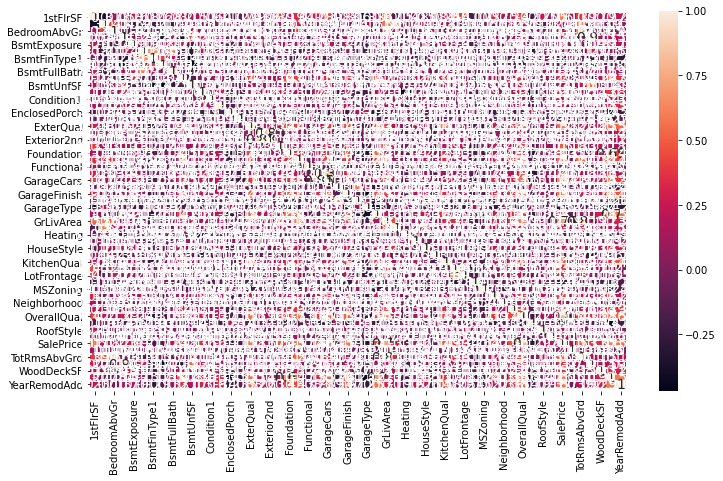

In [107]:
fig, ax=plt.subplots(figsize=(12,7))
ax =sns.heatmap(correlated_data.corr(), annot=True,annot_kws={'size': 14}) 
bottom, top = ax.get_ylim()
ax.set_ylim(bottom + 0.5, top - 0.5)

In [108]:
X1=correlated_data.drop(labels=['SalePrice'],axis=1)
Y1=correlated_data['SalePrice']
X1.head()

,1stFlrSF,2ndFlrSF,BedroomAbvGr,BsmtCond,BsmtExposure,BsmtFinSF1,BsmtFinType1,BsmtFinType2,BsmtFullBath,BsmtQual,BsmtUnfSF,CentralAir,Condition1,Electrical,EnclosedPorch,ExterCond,ExterQual,Exterior1st,Exterior2nd,Fireplaces,Foundation,FullBath,Functional,GarageArea,GarageCars,GarageCond,GarageFinish,GarageQual,GarageType,GarageYrBlt,GrLivArea,HalfBath,Heating,HeatingQC,HouseStyle,KitchenAbvGr,KitchenQual,LotArea,LotFrontage,LotShape,MSZoning,MasVnrArea,Neighborhood,OpenPorchSF,OverallQual,PavedDrive,RoofStyle,SaleCondition,ScreenPorch,TotRmsAbvGrd,TotalBsmtSF,WoodDeckSF,YearBuilt,YearRemodAdd
Id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1,6.753438,6.751101,1.386294,1.386294,0.000000,6.561031,0.693147,0.0,0.693147,0.693147,5.017280,0.693147,1.098612,1.609438,0.000000,0.0,0.693147,2.564949,2.639057,0.000000,1.098612,1.098612,0.0,6.308098,1.098612,0.0,0.693147,0.0,0.693147,7.602900,7.444833,0.693147,0.693147,0.693147,1.791759,0.693147,0.693147,9.042040,4.189655,1.386294,1.386294,5.283204,1.791759,4.127134,2.079442,0.0,0.693147,1.609438,0.0,2.197225,6.753438,0.000000,7.602900,7.602900
2,7.141245,0.000000,1.386294,1.386294,1.609438,6.886532,1.098612,0.0,0.000000,0.693147,5.652489,0.693147,0.693147,1.609438,0.000000,0.0,0.000000,2.197225,2.197225,0.693147,0.693147,1.098612,0.0,6.133398,1.098612,0.0,0.693147,0.0,0.693147,7.589336,7.141245,0.000000,0.693147,0.693147,1.098612,0.693147,0.000000,9.169623,4.394449,1.386294,1.386294,0.000000,3.218876,0.000000,1.945910,0.0,0.693147,1.609438,0.0,1.945910,7.141245,5.700444,7.589336,7.589336
3,6.825460,6.765039,1.386294,1.386294,1.098612,6.188264,0.693147,0.0,0.693147,0.693147,6.075346,0.693147,1.098612,1.609438,0.000000,0.0,0.693147,2.564949,2.639057,0.693147,1.098612,1.098612,0.0,6.411818,1.098612,0.0,0.693147,0.0,0.693147,7.601902,7.488294,0.693147,0.693147,0.693147,1.791759,0.693147,0.693147,9.328212,4.234107,0.000000,1.386294,5.093750,1.791759,3.761200,2.079442,0.0,0.693147,1.609438,0.0,1.945910,6.825460,0.000000,7.601902,7.602401
4,6.869014,6.629363,1.386294,1.609438,0.000000,5.379897,1.098612,0.0,0.693147,0.000000,6.293419,0.693147,1.098612,1.609438,5.609472,0.0,0.000000,2.639057,2.772589,0.693147,0.000000,0.693147,0.0,6.466145,1.386294,0.0,0.000000,0.0,1.791759,7.600402,7.448916,0.000000,0.693147,1.098612,1.791759,0.693147,0.693147,9.164401,4.110874,0.000000,1.386294,0.000000,1.945910,3.583519,2.079442,0.0,0.693147,0.000000,0.0,2.079442,6.629363,0.000000,7.557995,7.586296
5,7.044033,6.960348,1.609438,1.386294,1.386294,6.486161,0.693147,0.0,0.693147,0.693147,6.196444,0.693147,1.098612,1.609438,0.000000,0.0,0.693147,2.564949,2.639057,0.693147,1.098612,1.098612,0.0,6.729824,1.386294,0.0,0.693147,0.0,0.693147,7.601402,7.695758,0.693147,0.693147,0.693147,1.791759,0.693147,0.693147,9.565284,4.442651,0.000000,1.386294,5.860786,2.772589,4.442651,2.197225,0.0,0.693147,1.609438,0.0,2.302585,7.044033,5.262690,7.601402,7.601402


In [109]:
X1_train,X1_test,Y1_train,Y1_test=train_test_split(X1,Y1,test_size=0.2,random_state=0)
print(X1_train.shape,X1_test.shape,Y1_train.shape,Y1_test.shape)

(1142, 54) (286, 54) (1142,) (286,)


In [110]:
lr=LinearRegression()
lr.fit(X1_train,Y1_train)

LinearRegression()

In [111]:
Y1_predict=lr.predict(X1_test)

In [112]:
score=r2_score(Y1_test,Y1_predict)
mae=mean_absolute_error(Y1_test,Y1_predict)
mse=mean_squared_error(Y1_test,Y1_predict)
rmse=(np.sqrt(mean_squared_error(Y1_test,Y1_predict)))
print('r2_score: ',score)
print('mean_absolute_error: ',mae)
print('mean_squared_error: ',mse)
print('root_mean_squared_error: ',rmse)

r2_score:  0.8965574301404706
mean_absolute_error:  0.09396613950410869
mean_squared_error:  0.016125746597105407
root_mean_squared_error:  0.1269871906812077


In [141]:
from sklearn .model_selection import KFold, cross_val_score
from sklearn.metrics import make_scorer, r2_score

In [142]:
def test_model(model, X1_train=X1_train, Y1_train=Y1_train):
    cv=KFold(n_splits=3, shuffle=True, random_state=0)
    r2=make_scorer(r2_score)
    r2_val_score=cross_val_score(model, X1_train, Y1_train, cv=cv, scoring=r2)
    score=[r2_val_score.mean()]
    return score

In [143]:
import sklearn.linear_model as linear_model
LR=linear_model.LinearRegression()

In [144]:
test_model(LR)

[0.8861666590717284]

In [149]:
rdg=linear_model.Ridge()
test_model(rdg)

[0.8828233012141079]

In [151]:
lasso=linear_model.Lasso(alpha=1e-4)
test_model(lasso)

[0.8852247129750933]

In [152]:
from sklearn.svm import SVR
svr_reg=SVR(kernel='rbf')
test_model(svr_reg)

[0.8454348911197722]

In [156]:
from sklearn.ensemble import BaggingRegressor, GradientBoostingRegressor
br_reg = BaggingRegressor(n_estimators=1000, random_state=0)
gbr_reg = GradientBoostingRegressor(n_estimators=1000, learning_rate=0.1, loss='ls',random_state=0)

In [154]:
test_model(br_reg)

[0.8616802854309024]

In [155]:
test_model(gbr_reg)

[0.8893067911813733]

In [158]:
import xgboost
xgb_reg=xgboost.XGBRegressor()
test_model(xgb_reg)

[0.8580597984936228]

In [160]:
svr_reg.fit(X1_train,Y1_train)
y_pred=np.exp(svr_reg.predict(X1_test)).round(2)

In [161]:
y_pred

array([104910.13, 133376.72, 105311.11, 194916.3 , 121933.3 , 124238.12,
       209841.96, 148113.83, 123568.13, 113375.39, 214971.07, 188972.18,
       117972.35, 304330.47, 187551.92, 171032.41, 268154.07, 235075.54,
       187213.38,  98544.89, 255513.71, 160889.6 , 309070.39, 201787.46,
       151888.22, 159845.8 , 172224.41, 137118.31, 126297.2 , 247280.96,
       123274.93, 236821.78, 154417.71, 155115.13, 110285.44, 135189.84,
       249093.46, 112187.81, 146788.51,  81223.46,  90275.99, 190943.24,
       223843.98, 231144.71, 142446.73, 266959.02, 162720.23, 197612.67,
       115509.39, 254214.11, 204725.55, 123630.67, 140844.65, 180324.71,
       231067.35, 139597.57, 121564.01, 176866.54, 137640.18, 227629.52,
       200584.  , 134849.6 , 260797.62, 200190.32, 188334.28, 148058.78,
       219468.45, 225816.93, 151606.72, 190247.33, 198790.14, 145465.03,
       120261.19, 301524.41, 194072.32, 323410.58, 223099.5 , 207149.78,
       162842.74,  85448.3 , 198300.11, 246976.3 , 

In [166]:
submitva1=pd.concat([test_df['Id'],pd.DataFrame(y_pred)],axis=1)
submitva1.columns=['Id','SalePrice']

In [187]:
submitva1.isnull().sum()

Id              0
SalePrice    1173
dtype: int64

In [168]:
submitva1.to_csv('sample_submission.csv',index=False)

In [169]:
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV

In [172]:
params={'kernel':['rbf'],
       'gamma':[1,0.1,0.01,0.001,0.0001],
       'C':[0.1,1,10,100,1000],
       'epsilon':[1,0.2,0.1,0.01,0.001,0.0001]}
rand_search=RandomizedSearchCV(svr_reg,param_distributions=params,n_jobs=1,cv=11)
rand_search.fit(X1_train,Y1_train)
rand_search.best_score_

0.8864722896917158

In [174]:
svr_reg=SVR(C=100, cache_size=200, coef0=0.0, degree=3, epsilon=0.01, gamma=0.0001,
            kernel='rbf', max_iter=1, shrinking=True, tol=0.001, verbose=False)
test_model(svr_reg)           

[0.004926930263814448]

In [186]:
xgb2_reg=xgboost.XGBRegressor(n_estimator=899, mon_child_weight=2,max_depth=8,learning_rate=0.33,booster='gbtree')
test_model(xgb2_reg)

[11:56:56] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.3.0/src/learner.cc:541: 
Parameters: { mon_child_weight, n_estimator } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[11:56:56] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.3.0/src/learner.cc:541: 
Parameters: { mon_child_weight, n_estimator } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[11:56:57] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.3.0/src/learner.cc:541: 
Parameters: { mon_child_weight, n_estimator } might not be used.

  This may not be 

[0.8548407537327908]